In [3]:
#%reload_ext autoreload
%load_ext autoreload
%autoreload 2
%matplotlib inline

import os
import glob
import time
import re
import sys
import pprint

import numpy as np
import pandas as pd

import scipy.signal
import scipy.misc
import scipy.ndimage.filters

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec

import statsmodels.api as sm

import sklearn.decomposition
import sklearn.metrics

import skimage.filters
import skimage.util

import cv2
import SimpleITK as sitk

from ipywidgets import interact, interactive, fixed
#from IPython.html import widgets
import ipywidgets as widgets
from IPython.display import clear_output, display, HTML
from detect_peaks import detect_peaks

import registration_utilities as ru
import registration_callbacks as rc

import utils

# matplotlib.style.use('classic')

#Some nice default configuration for plots
plt.rcParams['figure.figsize'] = 30, 7.5
plt.rcParams['axes.grid'] = True
plt.gray()

linewidth = 4
markersize = 12
legendsize = 32  # 'medium'
labelsize = 28
ticksize = 20  # 'medium'
titlesize = 32  # large

plt.rcParams['xtick.labelsize'] = ticksize
plt.rcParams['ytick.labelsize'] = ticksize
plt.rcParams['lines.linewidth'] = linewidth
plt.rcParams['lines.markersize'] = markersize
plt.rcParams['axes.labelsize'] = labelsize
plt.rcParams['legend.fontsize'] = legendsize
plt.rcParams['axes.titlesize'] = titlesize
plt.rcParams['text.usetex'] = False

plt.rcParams['legend.loc'] = 'upper right'
plt.rcParams['grid.color'] = 'k'
plt.rcParams['grid.linestyle'] = ':'
plt.rcParams['grid.linewidth'] = 0.5

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Set results root directory

In [4]:
#resultsRootDir = '.'
#resultsRootDir = 'results'
#resultsRootDir = 'resultsPaper'
resultsRootDir = 'paper_figures'

DEBUG_MODE = False

## Load Image Data From Disk

##### Set the data root directory here

In [5]:
#dataRootDir = 'data/SHeart-HRes-LFPS/'
#dataRootDir = 'data/SHeart2015-01-21/'
#dataRootDir = 'data/SHeart2015-02-20-HRes-HFPS/'
# dataRootDir = 'data/fromMonte/Validation_Study_Export27July2015/'
dataRootDir = 'data/fromMonte/Validation_Study_Export27July2015/decoded/'

# List all readable data files
dataFiles = {'prefix': [],
             'ext': [],
             'path': []}

i = 0
for f in os.listdir(dataRootDir):
    
    prefix, ext = os.path.splitext(f)
    
    if ext not in ['.mha', '.avi', '.tif', '.mp4']:        
        continue        
    else:
        print '%d: %s' % (i, f)        
        dataFiles['prefix'].append(prefix)
        dataFiles['ext'].append(ext)
        dataFiles['path'].append( os.path.join(dataRootDir, f) )
        i += 1    

0: 2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha
1: 2015-07-27-10-36-06_2015-07-15-16-56-36_1.raw.bmode.mha
2: 2015-07-27-10-36-06_2015-07-15-16-56-46_1.raw.bmode.mha
3: 2015-07-27-10-36-06_2015-07-15-16-57-51_1.raw.bmode.mha
4: 2015-07-27-10-36-06_2015-07-15-16-57-35_1.raw.bmode.mha
5: 2015-07-27-10-36-06_2015-07-15-16-56-27_1.raw.bmode.mha


##### Select dataset to analyze

In [890]:
xyROI = {}
downsizeAmount = None
mmode_pos = None
outFPS = 30

# set parameters
if True: # decoded vevo2100 data from Monte
    
    datasetId = 0
    downsizeAmount = 0.5
    
    mmode_preset = [850, 850, 750, 750, 750, 850]
    mmode_pos_org = downsizeAmount * mmode_preset[datasetId]
    resizeAmount = 1.0

if False: # vevo2100 data AVIs from Monte
    
    datasetId = 6    
    downsizeAmount = None

    # xyROI = { 'min_X': 270, 'max_X': 520, 'min_Y': 82, 'max_Y': 266 }
    # mmode_pos = 190
    # resizeAmount = 2.0 # for opencv video display only    
    
    xyROI = { 'min_X': 115, 'max_X': 725, 'min_Y': 120, 'max_Y': 540 }
    # xyROI = { 'min_X': 400, 'max_X': 725, 'min_Y': 250, 'max_Y': 540 }  # chamber ROI
    mmode_pos_org = 590 # 590
    resizeAmount = 1.0 # for opencv video display only    

if False: # high-res probe High FPS
    
    datasetId = 2     
    downsizeAmount = 0.5
    xyROI = {'min_X': np.round(250 * downsizeAmount),
             'max_X': np.round(1300 * downsizeAmount), 
             'min_Y': np.round(40 * downsizeAmount) }
    #xyROI = { 'min_X': 600, 'max_X': 1000, 'min_Y': 300, 'max_Y': 750 }
    resizeAmount = 1.0 / downsizeAmount # for opencv video display only    

if False: # high-res probe Low FPS
    
    datasetId = 2 
    xyROI = { 'min_X': 150, 'max_X': 850 }
    resizeAmount = 0.75 # for opencv video display

if False: # Low-res probe
    
    datasetId = 7 
    framesPerSec = 10
    resizeAmount = 1.0 # for opencv video display only
    
print 'Selected dataset: ',  dataFiles['path'][datasetId]    

Selected dataset:  data/fromMonte/Validation_Study_Export27July2015/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha


##### Load selected dataset

In [891]:
# load data
print "\nLoading %s: \n" % (dataFiles['path'][datasetId])

if dataFiles['ext'][datasetId] == '.mha':
    
    imInput_sitk = sitk.ReadImage( dataFiles['path'][datasetId] )
    
    imInput_uncropped = np.transpose(sitk.GetArrayFromImage(imInput_sitk), [1, 2, 0])

    inputSpacing = np.array(imInput_sitk.GetSpacing())[[1, 0, 2]]
    
    if downsizeAmount is not None and downsizeAmount < 1.0:
        
        imInput_uncropped = scipy.ndimage.zoom(imInput_uncropped, 
                                               (downsizeAmount, downsizeAmount, 1))
         
        inputSpacing[:2] /= downsizeAmount
        
    print '\tSpacing: ', inputSpacing
    
    framesPerSec = 1000.0 / inputSpacing[2]
    # framesPerSec = 30
    
elif dataFiles['ext'][datasetId] in [ '.avi', '.tif', '.mp4' ]:    

    cap = cv2.VideoCapture(dataFiles['path'][datasetId])
    print cap.isOpened()
    cap.release()
    
    imInput_uncropped, metadata = utils.loadVideoFromFile(dataFiles['path'][datasetId], 
                                                          resizeAmount=downsizeAmount)
    
    if dataFiles['ext'][datasetId] == '.avi':
    
        if metadata.has_key('FPS'):
            framesPerSec = metadata['FPS']
            
        if metadata.has_key('FRAME_COUNT'):                           
            
            if metadata['FRAME_COUNT'] < imInput_uncropped.shape[2]:
                
                numChannels = imInput_uncropped.shape[2] / metadata['FRAME_COUNT']                
                print 'Video seems to be in color with %d channels' % numChannels
                imInput_highres_uncropped = imInput_uncropped[:,:,::numChannels]
        pass
else:    
    raise ValueError('Unknown file type %s' % dataFiles['ext'][datasetId])

print '\tImage Size: ', imInput_uncropped.shape
print '\tFrame rate: %f FPS' % framesPerSec


Loading data/fromMonte/Validation_Study_Export27July2015/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha: 

	Spacing:  [ 0.0239362   0.0239444   4.28992987]
	Image Size:  (376, 505, 300)
	Frame rate: 233.104044 FPS


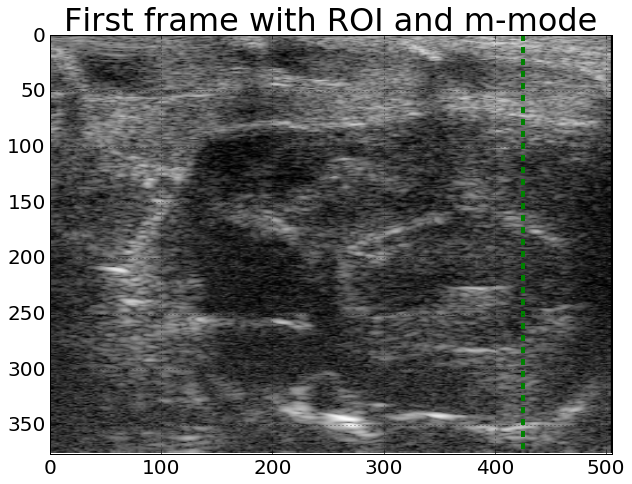

In [892]:
# show first frame
plt.figure()

plt.imshow(imInput_uncropped[:, :, 0])

if all(k in xyROI for k in ['min_X', 'max_X', 'min_Y', 'max_Y']):

    plt.gca().add_patch( 
        mpatches.Rectangle((xyROI['min_X'], xyROI['min_Y']),
                          xyROI['max_X'] - xyROI['min_X'] + 1, 
                          xyROI['max_Y'] - xyROI['min_Y'] + 1, 
                           fill=False, color='r', linestyle='--') 
    )

    if mmode_pos_org is not None:

        plt.plot([mmode_pos_org, mmode_pos_org], 
                 [xyROI['min_Y'], xyROI['max_Y']], 'g--', linewidth=4.0)
        
else:
    
    if mmode_pos_org is not None:

        plt.plot([mmode_pos_org, mmode_pos_org], 
                 [0, imInput_uncropped.shape[0]], 'g--', linewidth=4.0)
    
plt.xlim([0, imInput_uncropped.shape[1]])
plt.ylim([imInput_uncropped.shape[0], 0])
_ = plt.title('First frame with ROI and m-mode')


Image Size After Cropping:  (376, 505, 300)


Text(0.5,1,u'M-mode of input')

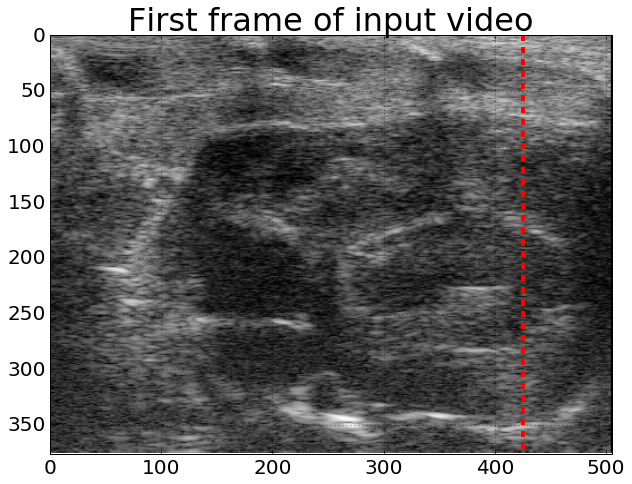

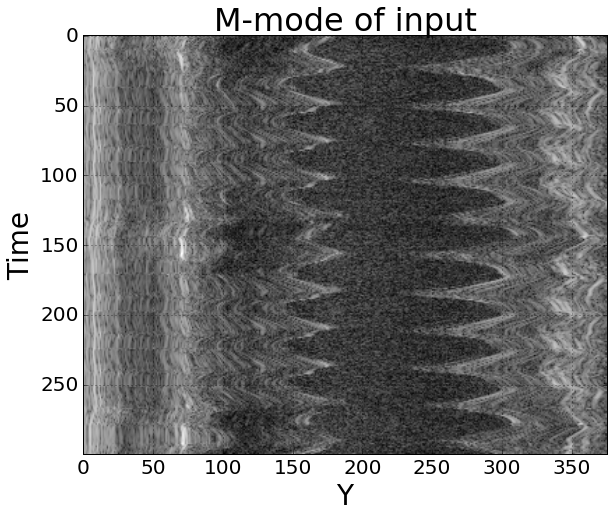

In [893]:
# crop if requested
xBounds = [0, imInput_uncropped.shape[1]]

if xyROI.has_key('min_X'):
    xBounds[0] = xyROI['min_X']    
if xyROI.has_key('max_X'):    
    xBounds[1] = xyROI['max_X']

yBounds = [0, imInput_uncropped.shape[0]]

if xyROI.has_key('min_Y'):
    yBounds[0] = xyROI['min_Y']    
if xyROI.has_key('max_Y'):    
    yBounds[1] = xyROI['max_Y']
    
imInput = imInput_uncropped[yBounds[0]:yBounds[1], xBounds[0]:xBounds[1], :] 

print '\nImage Size After Cropping: ', imInput.shape

if mmode_pos_org is None:    
    mmode_pos = imInput.shape[1] / 2
elif xyROI.has_key('min_X'):
    mmode_pos = mmode_pos_org - xyROI['min_X']
else:
    mmode_pos = mmode_pos_org
mmode_pos = np.int(mmode_pos)
    
# show first frame
plt.figure()

plt.imshow(imInput[:, :, 0])
plt.plot([mmode_pos, mmode_pos], [0, imInput.shape[0]], 
         'r--', linewidth=4.0)

plt.xlim([0, imInput.shape[1]])
plt.ylim([imInput.shape[0], 0])
_ = plt.title('First frame of input video')

# show mid XT slice of downsampled input before and after noise
plt.figure()

plt.imshow(imInput[:, mmode_pos, :].T)
plt.xlabel('Y')
plt.ylabel('Time')
plt.title('M-mode of input')

In [894]:
# make results dir
resultFilePrefix = dataFiles['prefix'][datasetId]

resultsDir = os.path.join(resultsRootDir, 
                          os.path.split( os.path.abspath(dataRootDir) )[1], 
                          dataFiles['prefix'][datasetId])
if not os.path.exists(resultsDir):
    os.makedirs(resultsDir)
    
print 'Results store directory: ', resultsDir    

Results store directory:  paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode


In [895]:
# write original input video
utils.writeVideoToFile(
    utils.normalizeArray( utils.AddTextOnVideo(imInput, 'Input - %.2f fps' % framesPerSec) ) * 255, 
    os.path.join(resultsDir, 'Input.avi'), 
    codec='DIVX', fps=outFPS
)

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input.avi took 3.07595705986 seconds


In [896]:
if DEBUG_MODE:
    
    # show video
    utils.cvShowVideo(utils.normalizeArray(imInput), 'Input Video', resizeAmount=resizeAmount)

#### Read physiological measurments file

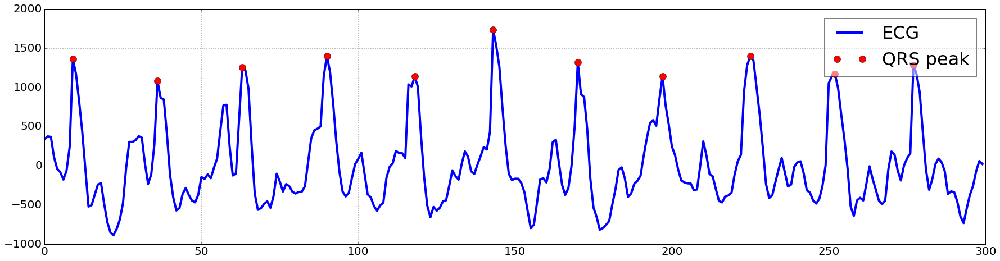

In [897]:
fname = os.path.basename(dataFiles['path'][datasetId])
fname_wout_ext = os.path.splitext(fname)[0]
bmode_physio_file = os.path.join(dataRootDir, fname_wout_ext + '.csv')
df = pd.read_csv(bmode_physio_file, skipinitialspace=True)

ecg_norm = utils.normalizeArray(df.ECG)
qrs_ploc = detect_peaks(ecg_norm, mpd=28 * 0.75, valley=False, mph = 0.5, show=False)

fig, ax = plt.subplots(1)

ax.plot(df.ECG, label='ECG')
ax.plot(qrs_ploc, df.ECG[qrs_ploc], 'ro', label='QRS peak')
ax.legend(framealpha=0.5)

Text(0.5,1,u'Instantaneous phase of ECG')

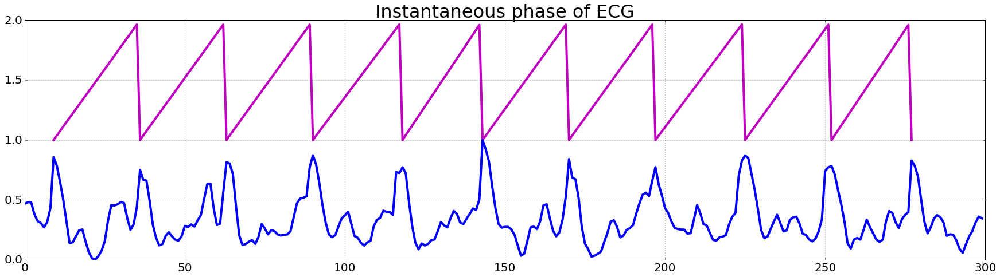

In [898]:
def compute_phase_from_ecg(sig_ecg, qrs_ploc):
    """
    Reference
    ---------
    
    * Rosenblum, "Phase synchronization: from theory to data analysis"
    """
    
    ph_ecg = np.zeros(sig_ecg.shape)
    
    for i in range(len(qrs_ploc)):
        
        if i > 0:
            dist = np.float(qrs_ploc[i] - qrs_ploc[i-1])
            ph_ecg[qrs_ploc[i-1]:qrs_ploc[i]] = (np.arange(qrs_ploc[i-1], qrs_ploc[i]) - qrs_ploc[i-1]) / dist
            
    return ph_ecg

ph_ecg = compute_phase_from_ecg(ecg_norm, qrs_ploc)

plt.plot(np.arange(qrs_ploc[0], qrs_ploc[-1]+1), ph_ecg[qrs_ploc[0]:qrs_ploc[-1]+1]+1, 'm-')
plt.plot(ecg_norm)
plt.title('Instantaneous phase of ECG')

#### Show five evenly spaced frames between two qrs peaks

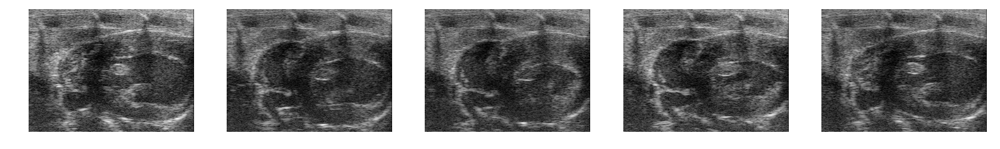

In [899]:
f = range(qrs_ploc[1], qrs_ploc[2], (qrs_ploc[2] - qrs_ploc[1]) / 4)

fig, ax = plt.subplots(1, len(f))

for i in range(len(f)):
    
    ax[i].imshow(imInput[:, :, f[i]])
    ax[i].axis('off')

### Run the algorithm

In [900]:
import uspgs

In [901]:
# Parameters
algo_params = {
    
    'median_filter_size': 1,
    'apply_lr_denoising': False,    
    'lr_gamma_factor': 2,
    'lr_xy_downsampling': 0.5,
    'lr_conv_tol': 1e-4,
    
    'similarity_method': 'ncorr',  # 'ncorr' or 'pca'
    'detrend_method': 'hp',  # 'lowess' or 'hp'
    'lowess_mode': '-',
    'hp_lamda': 6400,
    
    'respiration_present': True,
    'resp_phase_cutoff': 0.2
}

print algo_params

algo = uspgs.USPGS(**algo_params)
algo.set_input(imInput, framesPerSec)
algo.process() 

{'lr_gamma_factor': 2, 'similarity_method': 'ncorr', 'detrend_method': 'hp', 'lowess_mode': '-', 'hp_lamda': 6400, 'median_filter_size': 1, 'lr_conv_tol': 0.0001, 'respiration_present': True, 'apply_lr_denoising': False, 'lr_xy_downsampling': 0.5, 'resp_phase_cutoff': 0.2}
Input video size:  (376, 505, 300)

>> Step-1: Suppressing noise ...


Noise suppression took 12.95 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 23.9652838707 seconds
Chose frame 48 as key frame
Estimated period = 27.27 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 31.67%

Phase estimation took 25.71 seconds

>> Done processing ... took a total of 38.68 seconds


In [902]:
# retrieve noise suppression results
imInputDenoised = algo.imInputDenoised_

if algo_params['apply_lr_denoising']:
    
    imD = algo.imD_
    imLowRank = algo.imLowRank_
    imSparse = algo.imSparse_

# retrieve phase estimation results
if algo_params['similarity_method'] == 'pca':
    X_proj = algo.X_proj_
    
simMat = algo.simMat_
simMat_Trend = algo.simMat_Trend_
simMat_Seasonal = algo.simMat_Seasonal_
spectralEntropy = algo.spectralEntropy_
fid_best = algo.fid_best_

ts = algo.ts_
ts_trend = algo.ts_trend_
ts_seasonal = algo.ts_seasonal_
period = algo.period_

ts_analytic = algo.ts_analytic_
ts_instaamp = algo.ts_instaamp_
ts_instaphase = algo.ts_instaphase_
ts_instaphase_nmzd = algo.ts_instaphase_nmzd_

ts_trend_analytic = algo.ts_trend_analytic_
ts_trend_instaamp = algo.ts_trend_instaamp_
ts_trend_instaphase = algo.ts_trend_instaphase_
ts_trend_instaphase_nmzd = algo.ts_trend_instaphase_nmzd_

image_aspect = np.float(imInput.shape[1]) / imInput.shape[0]
input_bounds = [imInput.min(), imInput.max()]

#### Investigate phase estimation

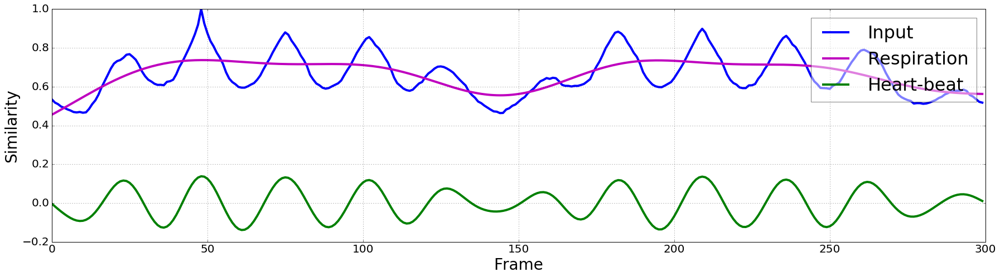

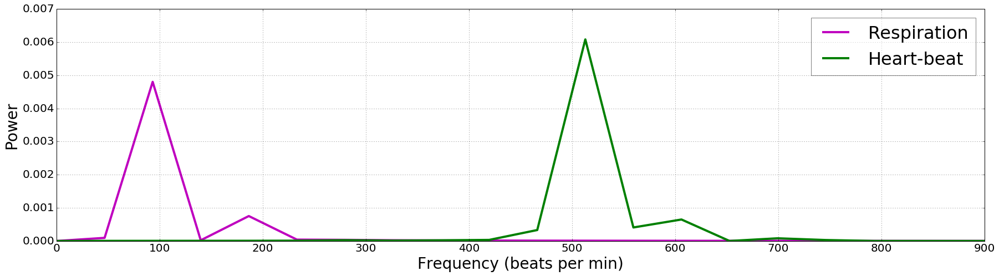

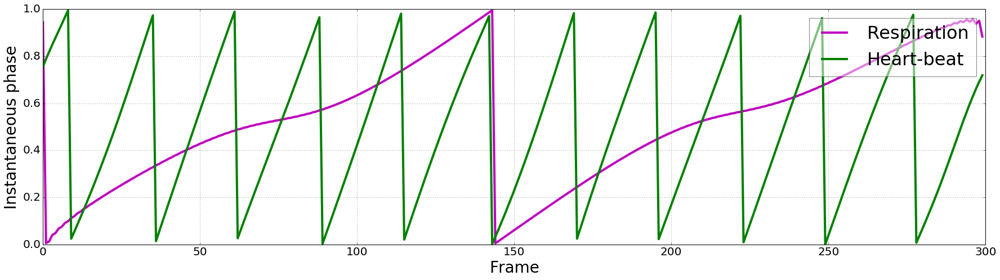

In [903]:
plt.figure()

plt.plot(ts, 'b-', label='Input')
plt.plot(ts_trend, 'm-', label='Respiration')
plt.plot(ts_seasonal, 'g-', label='Heart-beat')
plt.xlabel('Frame')
plt.ylabel('Similarity')
plt.xlim([0, imInput.shape[2]])
plt.legend(framealpha=0.5, loc='upper right')

# show frequency spectrum of trend and seasonal components
freq_trend, power_trend = scipy.signal.periodogram(ts_trend, framesPerSec)
freq_seasonal, power_seasonal = scipy.signal.periodogram(ts_seasonal, framesPerSec)

plt.figure()
plt.plot(freq_trend * 60, power_trend, 'm-', label='Respiration')
plt.plot(freq_seasonal * 60, power_seasonal, 'g-', label='Heart-beat')
plt.xlim([0, 900])
plt.xlabel('Frequency (beats per min)')
plt.ylabel('Power')
plt.legend(framealpha=0.5)

# show estimate instantaneous phase of heart-beat and respiration
plt.figure()
plt.plot(ts_trend_instaphase_nmzd, 'm-', label='Respiration')
plt.plot(ts_instaphase_nmzd, 'g-', label='Heart-beat')
plt.xlabel('Frame')
plt.ylabel('Instantaneous phase')
plt.xlim([0, imInput.shape[2]])
plt.legend(framealpha=0.5, loc='upper right')

#### Compare instantaneous phase against ECG

QRS peak         :  [  9  36  63  90 118 143 170 197 225 252 277]
instaphase valley:  [  9  36  62  89 115 143 170 196 223 249 278]
similarity valley:  [  9  36  61  89 114 143 170 195 223 249 277]

R^2 instaphase valley vs ECG =  0.99967271121

Difference between instaphase valley and qrs peak locations: 
	[0 0 1 1 3 0 0 1 2 3 1]
	Mean = 1.09, stddev = 1.08
	Median = 1, IQR = 1.50

Difference between the estimated and groundtruth instantaneous phase: 
	
	Mean = 0.06, stddev = 0.03
	Median = 0.06, IQR = 0.05


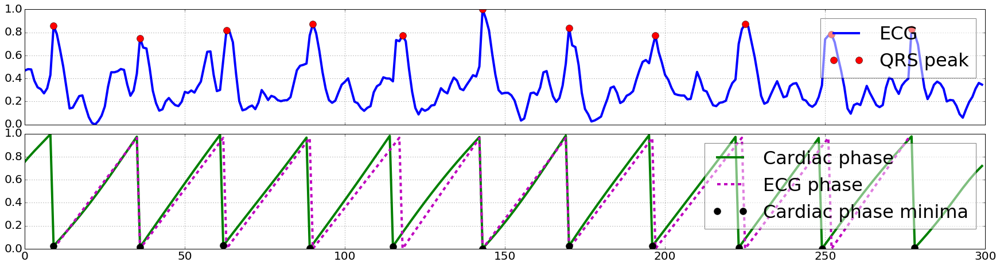

In [904]:
ecg_norm = utils.normalizeArray(df.ECG)

ts_seasonal_norm = utils.normalizeArray(ts_seasonal)
ts_seasonal_vloc = detect_peaks(ts_seasonal_norm, mpd=algo.period_ * 0.75, valley=True, show=False)

ts_instaphase_nmzd_vloc = detect_peaks(ts_instaphase_nmzd, mpd=algo.period_ * 0.65, valley=True, show=False)

num_points = min([qrs_ploc.size, ts_instaphase_nmzd_vloc.size])

print 'QRS peak         : ', qrs_ploc[:num_points]
print 'instaphase valley: ', ts_instaphase_nmzd_vloc[:num_points]
print 'similarity valley: ', ts_seasonal_vloc[:num_points]

print '\nR^2 instaphase valley vs ECG = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                    ts_instaphase_nmzd_vloc[:num_points])

insta_qrs_diff = np.abs(ts_instaphase_nmzd_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between instaphase valley and qrs peak locations: \n\t', insta_qrs_diff

print '\tMean = %.2f, stddev = %.2f' % (np.mean(insta_qrs_diff), np.std(insta_qrs_diff))
print '\tMedian = %d, IQR = %.2f' % (np.median(insta_qrs_diff), scipy.stats.iqr(insta_qrs_diff))

insta_ecg_phase_error = uspgs.phaseDist(ph_ecg[qrs_ploc[0]:qrs_ploc[num_points-1]], 
                                        ts_instaphase_nmzd[qrs_ploc[0]:qrs_ploc[num_points-1]])

print '\nDifference between the estimated and groundtruth instantaneous phase: \n\t'

print '\tMean = %.2f, stddev = %.2f' % (np.mean(insta_ecg_phase_error), np.std(insta_ecg_phase_error))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(insta_ecg_phase_error), scipy.stats.iqr(insta_ecg_phase_error))

fig, ax = plt.subplots(2, 1, sharex=True)
fig.subplots_adjust(hspace=0.08)

ax[0].plot(ecg_norm, 'b', label='ECG')
ax[0].plot(qrs_ploc, ecg_norm[qrs_ploc], 'ro', label='QRS peak')
ax[0].legend(framealpha = 0.5)

ax[1].plot(ts_instaphase_nmzd, 'g-', label='Cardiac phase')
ax[1].plot(np.arange(qrs_ploc[0], qrs_ploc[-1]), ph_ecg[qrs_ploc[0]:qrs_ploc[-1]], 'm--', label='ECG phase')
ax[1].plot(ts_instaphase_nmzd_vloc, ts_instaphase_nmzd[ts_instaphase_nmzd_vloc], 'ko', label='Cardiac phase minima')
ax[1].legend(framealpha = 0.5)

# plt.plot(ts_seasonal_norm, 'g-', label='heart')
# plt.plot(ts_seasonal_vloc, ts_seasonal_norm[ts_seasonal_vloc], 'mo')

_ = plt.setp([a.get_xticklabels() for a in ax[:-1]], visible=False)

##### Visually check evenly spaced between two consecutive QRS peaks or instaphase valleys

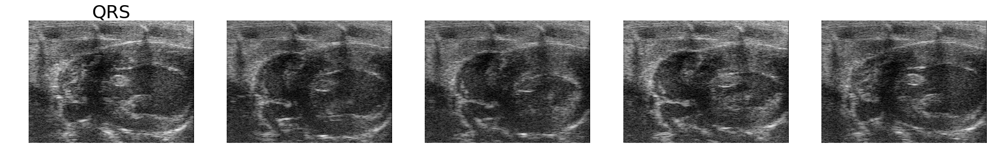

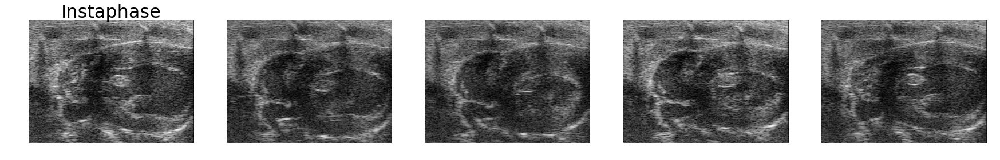

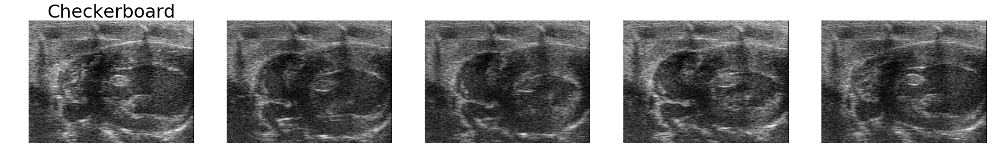

In [905]:
pid = 1
n_frames = 5

# QRS
plt.figure()

f_qrs = range(qrs_ploc[pid], qrs_ploc[pid+1], (qrs_ploc[pid+1] - qrs_ploc[pid]) / (n_frames - 1))

for i in range(len(f_qrs)):
    
    plt.subplot(1, len(f_qrs), i+1)
    plt.imshow(imInput[:, :, f_qrs[i]])
    plt.axis('off')
    
    if i == 0:
        plt.title('QRS')

# Instaphase    
plt.figure()

f_insta = range(ts_instaphase_nmzd_vloc[pid], ts_instaphase_nmzd_vloc[pid+1], 
          (ts_instaphase_nmzd_vloc[pid+1] - ts_instaphase_nmzd_vloc[pid]) / (n_frames - 1))

for i in range(len(f_insta)):
    
    plt.subplot(1, len(f_insta), i+1)
    plt.imshow(imInput[:, :, f_insta[i]])
    plt.axis('off')    

    if i == 0:
        plt.title('Instaphase')
        
        
# checkerboard    
plt.figure()

for i in range(len(f_qrs)):    
    
    im_chk = utils.vis_checkerboard(imInput[:, :, f_qrs[i]], imInput[:, :, f_insta[i]])
    
    plt.subplot(1, len(f_qrs), i+1)
    plt.imshow(im_chk)
    plt.axis('off')    

    if i == 0:
        plt.title('Checkerboard')        

#### Visually compare images at corresponding QRS peaks, instaphase valley, similarity valley

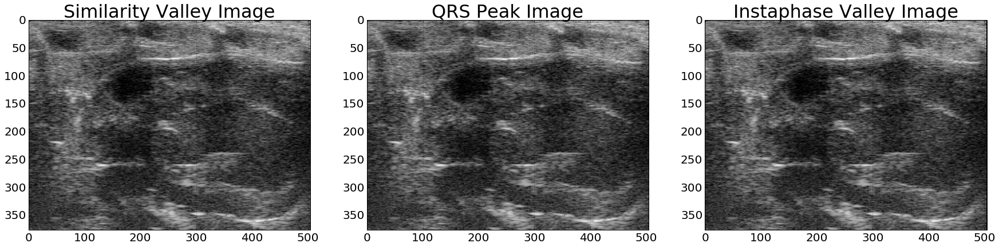

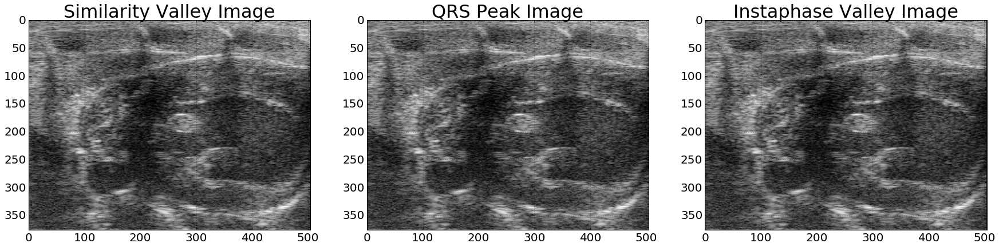

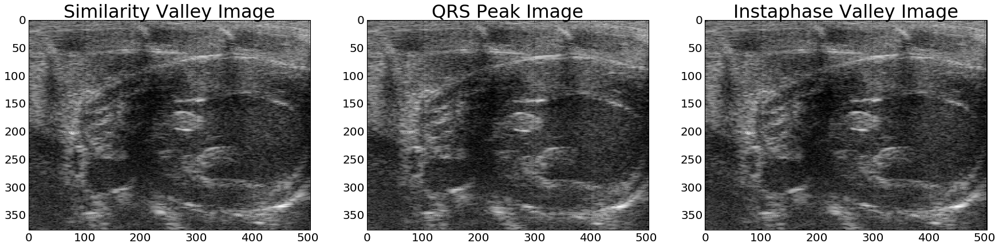

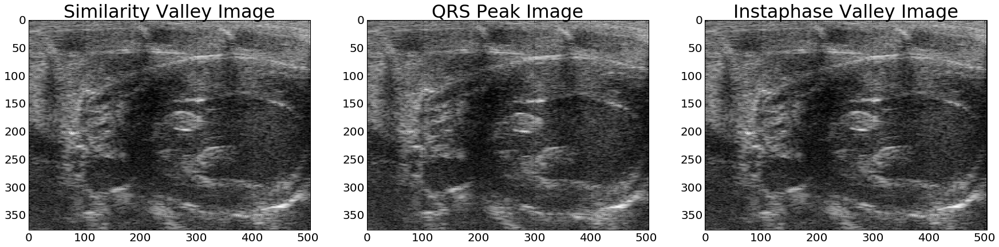

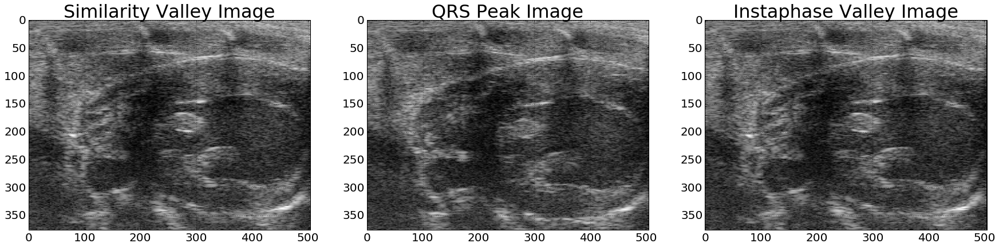

...

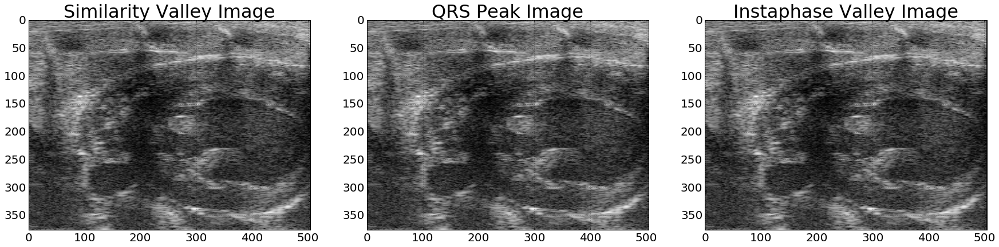

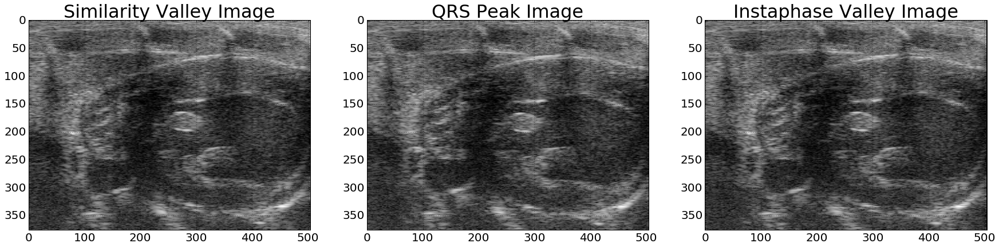

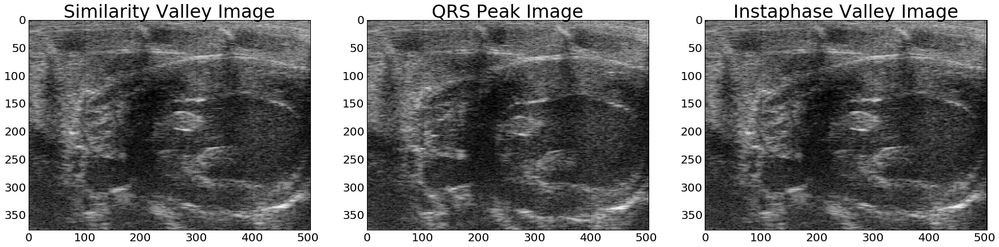

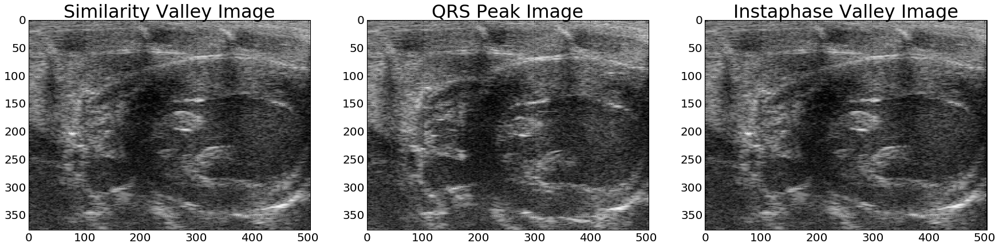

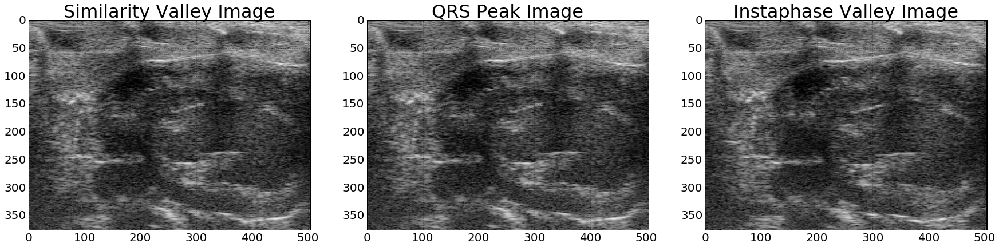

In [906]:
for i in range(np.min([qrs_ploc.size, ts_seasonal_vloc.size, ts_instaphase_nmzd_vloc.size])):
    
    plt.figure()

    plt.subplot(1, 3 ,1)
    plt.imshow(imInput[:, :, ts_seasonal_vloc[i]])
    plt.title('Similarity Valley Image')

    plt.subplot(1, 3 ,2)
    plt.imshow(imInput[:, :, qrs_ploc[i]])
    plt.title('QRS Peak Image')

    plt.subplot(1, 3, 3)
    plt.imshow(imInput[:, :, ts_instaphase_nmzd_vloc[i]])
    plt.title('Instaphase Valley Image')    

#### Investigate respiratory gating

31.67% frames gated due to respiration influence


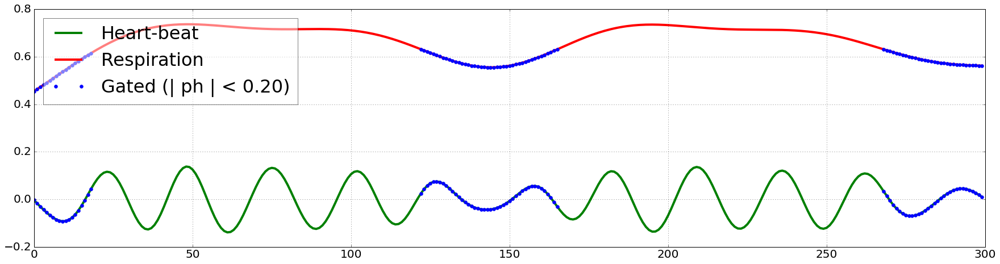

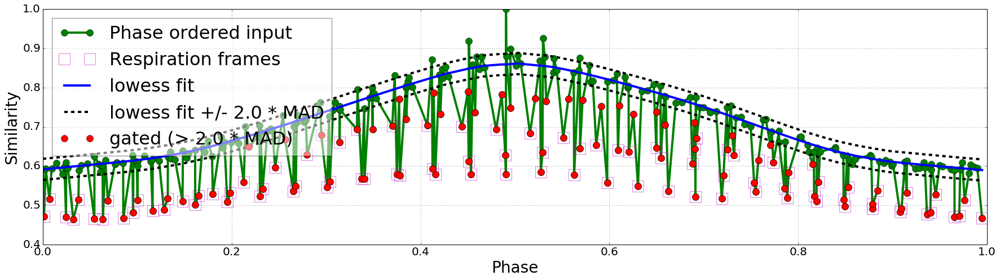

In [907]:
# show initial phase based respiration gating
resp_ind = algo.resp_ind_
print '%.2f%% frames gated due to respiration influence' % (100.0 * len(resp_ind) / len(ts))

plt.figure()
plt.plot(ts_seasonal, 'g-', label='Heart-beat')
plt.plot(ts_trend, 'r-', label='Respiration')
plt.plot(resp_ind, ts_seasonal[resp_ind], 'b.', label='Gated (| ph | < %.2f)' % algo.resp_phase_cutoff)
plt.plot(resp_ind, ts_trend[resp_ind], 'b.')
plt.legend(framealpha=0.5, loc='upper left');

# show lowess bases gating
phaseord_est = np.argsort(ts_instaphase_nmzd)

fid_lowess = algo.fid_lowess_
sim_lowess_reg = algo.sim_lowess_reg_

ph_resp = ts_instaphase_nmzd[resp_ind]
sim_resp = simMat[fid_lowess, resp_ind]

ph_org = ts_instaphase_nmzd[phaseord_est]
sim_org = simMat[fid_lowess, phaseord_est]

sim_lowess = sim_lowess_reg.predict(ph_org)

k_mad = 2.0
gated_ind = phaseord_est[np.argwhere(sim_lowess - sim_org > k_mad * sim_lowess_reg.residual_mad())]

ph_gated = ts_instaphase_nmzd[gated_ind]
sim_gated = simMat[fid_lowess, gated_ind]


imInput_phaseord = imInput[:,:,phaseord_est]

phaseord_est_gated = [fid for fid in phaseord_est if fid not in gated_ind]
imInput_phaseord_gated = imInput[: , :, phaseord_est_gated]

plt.figure()

plt.plot(ph_org, sim_org, 'g-o', label='Phase ordered input')
plt.plot(ph_resp, sim_resp, 'ms', label='Respiration frames',
         fillstyle='none', markersize=20)
plt.plot(ph_org, sim_lowess, 'b-', label='lowess fit')

plt.plot(ph_org, sim_lowess + k_mad * sim_lowess_reg.residual_mad(), 'k--')
plt.plot(ph_org, sim_lowess - k_mad * sim_lowess_reg.residual_mad(), 'k--', label='lowess fit +/- %.1f * MAD' % k_mad)

plt.plot(ph_gated, sim_gated, 'ro', label='gated (> %.1f * MAD)' % k_mad)

plt.xlabel('Phase')
plt.ylabel('Similarity')
plt.legend(loc='upper left', framealpha=0.5)

# evaluate quality of lowess fit
phaseord_est_wout_resp = [fid for fid in phaseord_est if fid not in resp_ind]

xs = ts_instaphase_nmzd[phaseord_est_wout_resp]
ys = simMat[fid_lowess, phaseord_est_wout_resp]
y_fit = sim_lowess_reg.predict(xs)

In [908]:
if DEBUG_MODE:
    
    # see phase ordered input after gating
    utils.cvShowVideo(
        [utils.normalizeArray(imInput_phaseord), utils.normalizeArray(imInput_phaseord_gated)],
        ['Input phase ordered video', 'Input phase ordered video after gating'], resizeAmount=resizeAmount
    )

#### Figures depicting noise suppression

In [909]:
#
# Show MIPs of Input, Lowrank and Sparse parts
#
dispframe = 0

if algo_params['apply_lr_denoising']:
    
    # Input
    plt.figure(figsize=(20,15))

    plt.subplot(141)
    mplotShowImage(imInput[:, :, dispframe])
    plt.title('Input')
    SaveImageToDisk(imInput.max(2), resultsDir, 'imInput')

    # smoothed input
    plt.subplot(142)
    mplotShowImage(imD[:, :, dispframe])
    plt.title('Median')
    SaveImageToDisk(imD.max(2), resultsDir, 'imMedian')

    # Low Rank
    plt.subplot(143)
    mplotShowImage(imLowRank[:, :, dispframe])
    plt.title('Low-rank')
    SaveImageToDisk(imLowRank.max(2), resultsDir, 'imLowRank')

    # Sparse
    plt.subplot(144)
    mplotShowImage(imSparse[:, :, dispframe])
    plt.title('Sparse')
    SaveImageToDisk(imSparse.max(2), resultsDir, 'imSparse')

    #
    # Show Mid XT slices of Input, Lowrank and Sparse parts
    #

    # Input
    plt.figure(figsize=(20, 10))

    plt.subplot(221)

    mplotShowImage(imInput[:, mmode_pos, :].T)
    plt.title('Input m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imInput[:, mmode_pos, :].T, resultsDir, 'imInput_mmode')

    # Smoothed Input
    plt.subplot(222)

    mplotShowImage(imD[:, mmode_pos, :].T)
    plt.title('Input median m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imD[:, mmode_pos, :].T, resultsDir, 'imMedian_mmode')

    # Low Rank
    plt.subplot(223)

    mplotShowImage(imLowRank[:, mmode_pos, :].T)
    plt.title('Lowrank m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imLowRank[:, mmode_pos, :].T, resultsDir, 'imLowRank_mmode')

    # Sparse
    plt.subplot(224)

    mplotShowImage(imSparse[:, mmode_pos, :].T)
    plt.title('Sparse m-mode')
    plt.xlabel('Time', fontsize=labelsize)
    plt.ylabel('Y', fontsize=labelsize)
    SaveImageToDisk(imSparse[:, mmode_pos, :].T, resultsDir, 'imSparse_mmode')

#### Figures depicting phase estimation

Heart rate = 512.83 bpm
Heart cycle = 27.27 frames
No of heart cycles recorded = 11.00

Respiration rate = 93.24 bpm
Respiration cycle = 27.27 frames
No of respiration cycles recorded = 2.00


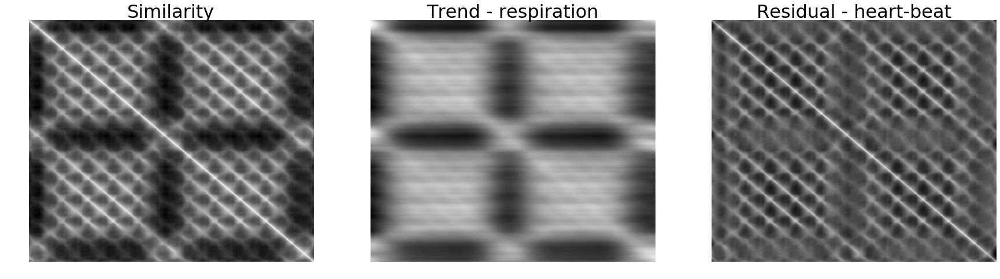

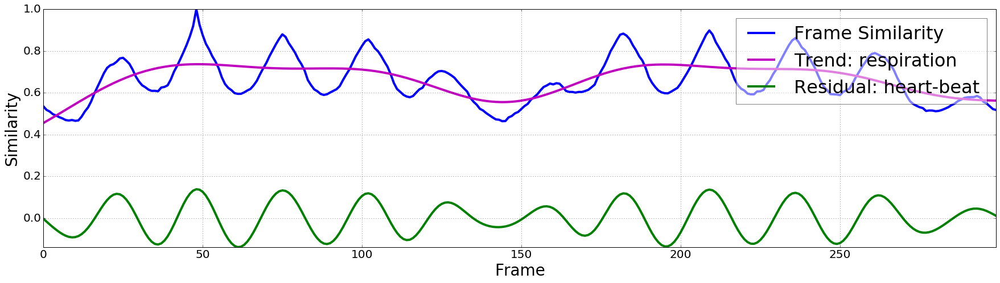

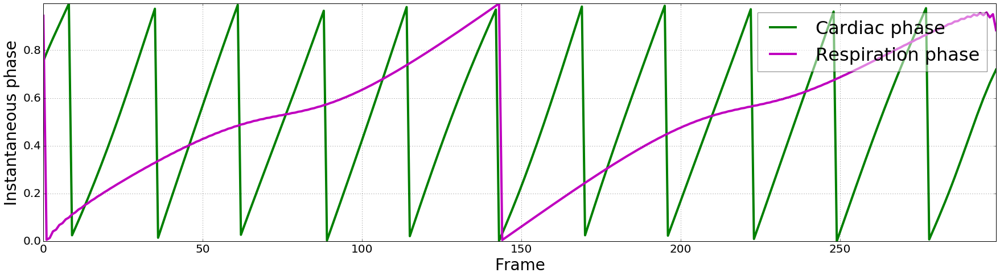

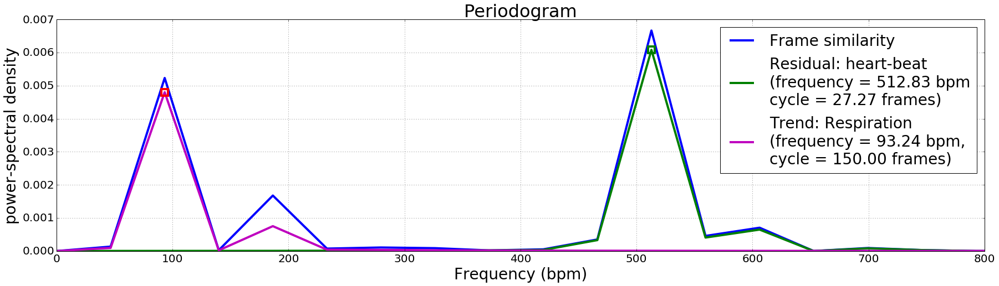

In [910]:
#
# plot the whole similarity landscape along with its trend and seasonal parts
#
fig, ax = plt.subplots(1, 3, sharey=True)

ax[0].imshow(simMat)
ax[0].set_title('Similarity')
ax[0].axis('off')
ax[0].axis('tight')

ax[1].imshow(simMat_Trend)
ax[1].set_title('Trend - respiration')
ax[1].axis('off')
ax[1].axis('tight')

ax[2].imshow(simMat_Seasonal)
ax[2].set_title('Residual - heart-beat')
ax[2].axis('off')
ax[2].axis('tight')

utils.SaveFigToDisk(resultsDir, 'simMat', bbox_inches='tight')

# Demonstrate season-trend decomposition
fig, ax = plt.subplots(1)

ax.plot(ts, 'b-', label=r'Frame Similarity')
ax.plot(ts_trend , 'm-', label='Trend: respiration')
ax.plot(ts_seasonal , 'g-', label='Residual: heart-beat')

ax.set_xlim([0, ts_trend.size])
ax.set_xlabel('Frame')
ax.set_ylabel('Similarity')
ax.legend(framealpha=0.5)
ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'season_trend_decomposition', bbox_inches='tight')

# show instantaneous phase of heart and respiration
fig, ax = plt.subplots(1)

ax.plot(ts_instaphase_nmzd, 'g-', label='Cardiac phase')
ax.plot(ts_trend_instaphase_nmzd, 'm-', label='Respiration phase')

ax.set_xlabel('Frame')
ax.set_ylabel('Instantaneous phase')
# ax.set_xlim([0, ts_instaphase_nmzd.size])

ax.legend(framealpha=0.5)
ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'instantaneous_phase', bbox_inches='tight')

# calculate periodicity characteristics
freq_seasonal, power_seasonal = scipy.signal.periodogram(ts_seasonal, framesPerSec)
max_power_loc_seasonal = np.argmax(power_seasonal)
period_seasonal = 1.0 / freq_seasonal[max_power_loc_seasonal]
bpm_seasonal = 60.0 / period_seasonal
num_periods_seasonal = ts_seasonal.size / (period_seasonal * framesPerSec)

print 'Heart rate = %.2f bpm' % bpm_seasonal
print 'Heart cycle = %.2f frames' % (period_seasonal * framesPerSec)
print 'No of heart cycles recorded = %.2f' % num_periods_seasonal

freq_trend, power_trend = scipy.signal.periodogram(ts_trend, framesPerSec)
max_power_loc_trend = np.argmax(power_trend)
period_trend = 1.0 / freq_trend[max_power_loc_trend]
bpm_trend = 60.0 / period_trend
num_periods_trend = ts_trend.size / (period_trend * framesPerSec)

print '\nRespiration rate = %.2f bpm' % bpm_trend
print 'Respiration cycle = %.2f frames' % (period_seasonal * framesPerSec)
print 'No of respiration cycles recorded = %.2f' % num_periods_trend

freq_sim, power_sim = scipy.signal.periodogram(ts, framesPerSec)

fig, ax = plt.subplots(1)

ax.plot(freq_sim * 60.0, power_sim, 'b-', label='Frame similarity')

ax.plot(freq_seasonal * 60.0, power_seasonal, 'g-', 
        label='Residual: heart-beat\n(frequency = %.2f bpm\n%scycle = %.2f frames)' % (
            bpm_seasonal, ''*12, period_seasonal * framesPerSec))

ax.plot(freq_seasonal[max_power_loc_seasonal] * 60.0, power_seasonal[max_power_loc_seasonal], 
        'gs', fillstyle='none', markeredgewidth=linewidth)

ax.plot(freq_trend * 60.0, power_trend, 'm-', 
        label='Trend: Respiration\n(frequency = %.2f bpm, \n%scycle = %.2f frames)' % (
            bpm_trend, ''*13, period_trend * framesPerSec))

ax.plot(freq_trend[max_power_loc_trend] * 60.0, power_trend[max_power_loc_trend], 
        'rs', fillstyle='none', markeredgewidth=linewidth)

ax.set_xlabel('Frequency (bpm)')
ax.set_ylabel('power-spectral density')
ax.set_xlim(0, 800)
ax.legend(fontsize=legendsize-4)
ax.set_title('Periodogram')
# ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'periodogram', bbox_inches='tight')

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input_ordered_by_ecg_phase.avi took 1.33538103104 seconds
True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input_ordered_by_our_phase.avi took 1.33464789391 seconds
True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input_ordered_by_our_phase_and_gated.avi took 0.888344049454 seconds


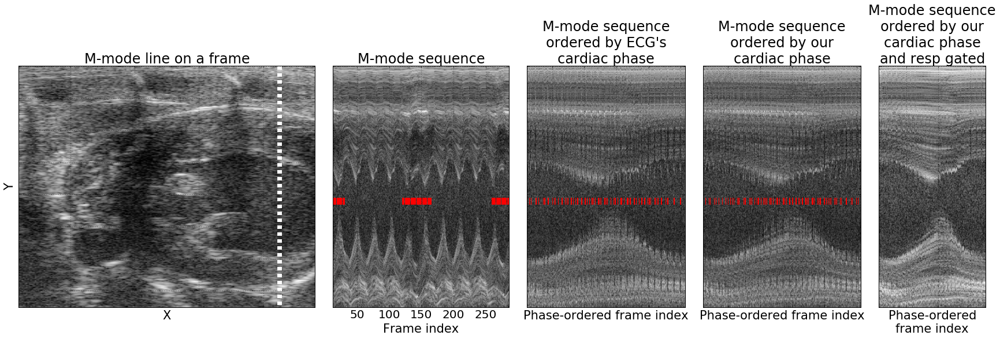

In [911]:
phase_est_aligned = (ts_instaphase_nmzd - ts_instaphase_nmzd[qrs_ploc[1]]) % 1

ind_phase_ord_ecg = [i for i in np.argsort(ph_ecg) if i >= qrs_ploc[0] and i <= qrs_ploc[-1]]
ind_phase_ord_est = [i for i in np.argsort(phase_est_aligned) if i >= qrs_ploc[0] and i <= qrs_ploc[-1]]
# ind_phase_ord_est = np.argsort(phase_est_aligned)
ind_phase_ord_est_gated = [i for i in ind_phase_ord_est if i not in gated_ind]

imInput_phase_ord_ecg = imInput[:, :, ind_phase_ord_ecg]

utils.writeVideoToFile(
    utils.normalizeArray(imInput_phase_ord_ecg) * 255, 
    os.path.join(resultsDir, 'Input_ordered_by_ecg_phase.avi'), 
    codec='DIVX', fps=outFPS
)

imInput_phase_ord_est = imInput[:, :, ind_phase_ord_est]

utils.writeVideoToFile(
    utils.normalizeArray(imInput_phase_ord_est) * 255, 
    os.path.join(resultsDir, 'Input_ordered_by_our_phase.avi'), 
    codec='DIVX', fps=outFPS
)

imInput_phase_ord_est_gated = imInput[:, :, ind_phase_ord_est_gated]

utils.writeVideoToFile(
    utils.normalizeArray(imInput_phase_ord_est_gated) * 255, 
    os.path.join(resultsDir, 'Input_ordered_by_our_phase_and_gated.avi'), 
    codec='DIVX', fps=outFPS
)

    
# show image sequence ordered by estimated phase
wratios = np.array([imInput.shape[1], 
                    imInput.shape[-1],
                    len(ind_phase_ord_ecg),
                    len(ind_phase_ord_est),
                    len(ind_phase_ord_est_gated)])

wratios = wratios / np.float(imInput.shape[1])

fig, ax = plt.subplots(1, 5, sharey=True, gridspec_kw={'width_ratios': wratios, 'wspace': 0.1})

tsize = 24
lsize = tsize - 3

ax[0].imshow(imInput[:, :, qrs_ploc[1]])
ax[0].plot([mmode_pos, mmode_pos], [0, imInput.shape[0]], 'w--', linewidth=8)
ax[0].set_xlabel('X', fontsize=lsize)
ax[0].set_ylabel('Y', fontsize=lsize)
ax[0].set_title('M-mode line on a frame', fontsize=tsize)

ax[1].imshow(imInput[:, mmode_pos, :])
ax[1].set_xticks(np.arange(0, imInput.shape[-1]+1, 50))
for i in range(imInput.shape[-1]):
    if i in gated_ind:
        ax[1].plot([i, i], [205, 215], 'r-', linewidth=1)
ax[1].set_xlabel('Frame index', fontsize=lsize)
ax[1].set_title('M-mode sequence', fontsize=tsize)
ax[1].grid('on')

ax[2].imshow(imInput_phase_ord_ecg[:, mmode_pos, :])
ax[2].set_xticks(np.arange(0, imInput_phase_ord_ecg.shape[-1]+1, 50))
for i in range(len(ind_phase_ord_ecg)):
    if ind_phase_ord_ecg[i] in gated_ind:
        ax[2].plot([i, i], [205, 215], 'r-', linewidth=1)
ax[2].set_xlabel('Phase-ordered frame index', fontsize=lsize)
ax[2].set_title("M-mode sequence\nordered by ECG's\ncardiac phase", fontsize=tsize)

ax[3].imshow(imInput_phase_ord_est[:, mmode_pos, :])
ax[3].set_xticks(np.arange(0, imInput_phase_ord_est.shape[-1]+1, 50))
for i in range(len(ind_phase_ord_est)):
    if ind_phase_ord_est[i] in gated_ind:
        ax[3].plot([i, i], [205, 215], 'r-', linewidth=1)
ax[3].set_xlabel('Phase-ordered frame index', fontsize=lsize)
ax[3].set_title('M-mode sequence\nordered by our\ncardiac phase', fontsize=tsize)

ax[4].imshow(imInput_phase_ord_est_gated[:, mmode_pos, :])
ax[4].set_xticks(np.arange(0, imInput_phase_ord_est_gated.shape[-1]+1, 50))
ax[4].set_xlabel('Phase-ordered\nframe index', fontsize=lsize)
ax[4].set_title('M-mode sequence\nordered by our\ncardiac phase\nand resp gated', fontsize=tsize)

_ = plt.setp([ax[i].get_xticklabels() for i in range(len(ax)) if i != 1], visible=False)
_ = plt.setp([ax[i].get_yticklabels() for i in range(len(ax))], visible=False)

utils.SaveFigToDisk(resultsDir, 'phaseordered', bbox_inches='tight')

#### Figures validating phase estimation

QRS peak         :  [  9  36  63  90 118 143 170 197 225 252 277]
instaphase valley:  [  9  36  62  89 115 143 170 196 223 249 278]
similarity valley:  [  9  36  61  89 114 143 170 195 223 249 277]

R^2 instaphase valley vs ECG =  0.99967271121

Difference between instaphase valley and qrs peak locations: 
	[0 0 1 1 3 0 0 1 2 3 1]
	Mean = 1.09, std = 1.08
	Median = 1.00, IQR = 1.50

Difference between the estimated and groundtruth instantaneous phase: 
	
	Mean = 0.06, stddev = 0.03
	Median = 0.06, IQR = 0.05
	Range = [0.00, 0.14]


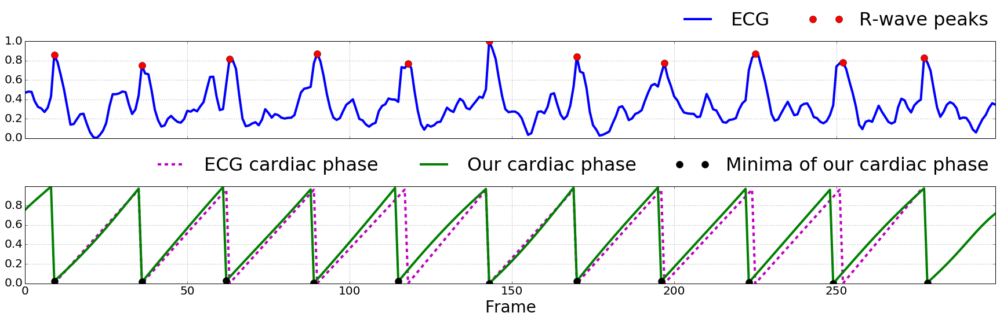

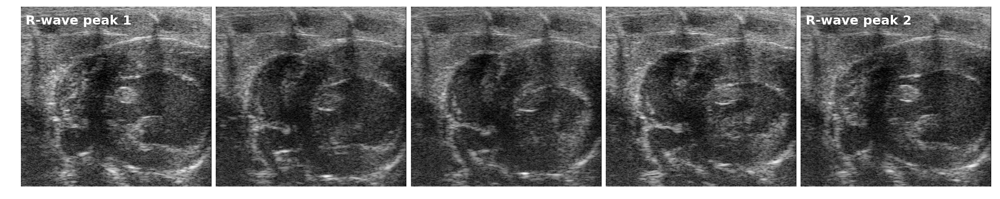

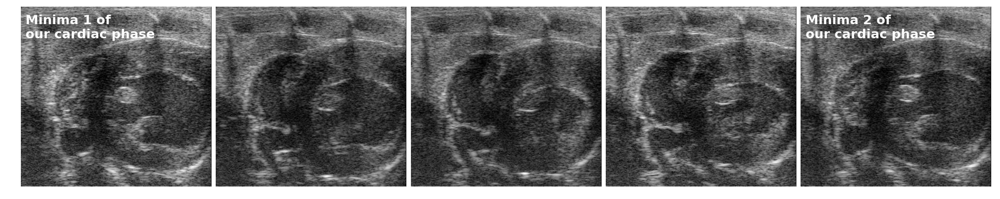

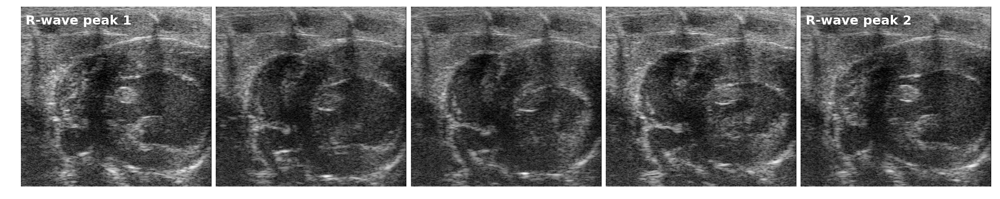

In [912]:
# overlay ECG and instantaneous phase
fig, ax = plt.subplots(2, 1, sharex=True)

fig.subplots_adjust(wspace=0.025, hspace=0.5)

ax[0].plot(ecg_norm, 'b', label='ECG')
ax[0].plot(qrs_ploc, ecg_norm[qrs_ploc], 'ro', label='R-wave peaks')
ax[0].legend(bbox_to_anchor=(1.01, 0.95), loc='lower right', ncol=2, framealpha=0)
ax[0].axis('tight')

ax[1].plot(np.arange(qrs_ploc[0], qrs_ploc[-1]), ph_ecg[qrs_ploc[0]:qrs_ploc[-1]], 'm--', label='ECG cardiac phase')
ax[1].plot(ts_instaphase_nmzd, 'g-', label='Our cardiac phase')
ax[1].plot(ts_instaphase_nmzd_vloc, ts_instaphase_nmzd[ts_instaphase_nmzd_vloc], 'ko', label='Minima of our cardiac phase')
ax[1].set_xlabel('Frame')
ax[1].legend(bbox_to_anchor=(1.01, 0.95), loc='lower right', ncol=3, framealpha=0)
ax[1].axis('tight')

_ = plt.setp([a.get_xticklabels() for a in ax[:-1]], visible=False)

utils.SaveFigToDisk(resultsDir, 'ecg_instaphase_overlay', bbox_inches='tight')

### show evenly spaced frames between two consecutive QRS peaks and corresponding instantaneous phase valley
pid = 1
n_frames = 5

# QRS
f_qrs = range(qrs_ploc[pid], qrs_ploc[pid+1]+1, (qrs_ploc[pid+1] - qrs_ploc[pid]) / (n_frames - 1))

fig, ax = plt.subplots(1, len(f_qrs), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_qrs)):
    
    ax[i].imshow(imInput[:, :, f_qrs[i]])
    
    if i == 0:
        ax[i].annotate('R-wave peak 1', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('R-wave peak 2', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')
    
utils.SaveFigToDisk(resultsDir, 'qrs_peak_to_peak', bbox_inches='tight')

# Instaphase    
f_insta = range(ts_instaphase_nmzd_vloc[pid], ts_instaphase_nmzd_vloc[pid+1]+1, 
                (ts_instaphase_nmzd_vloc[pid+1] - ts_instaphase_nmzd_vloc[pid]) / (n_frames - 1))

fig, ax = plt.subplots(1, len(f_insta), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_insta)):
    
    ax[i].imshow(imInput[:, :, f_insta[i]])    
    
    if i == 0:
        ax[i].annotate('Minima 1 of\nour cardiac phase', xy=(0.05, 0.9), xytext=(0.025, 0.825), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('Minima 2 of\nour cardiac phase', xy=(0.05, 0.9), xytext=(0.025, 0.825), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')    

utils.SaveFigToDisk(resultsDir, 'instaphase_valley_to_valley', bbox_inches='tight')        
        
# checkerboard    
fig, ax = plt.subplots(1, len(f_qrs), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_qrs)):    
    
    im_chk = utils.vis_checkerboard(imInput[:, :, f_qrs[i]], imInput[:, :, f_insta[i]])
    
    ax[i].imshow(im_chk)
    
    if i == 0:
        ax[i].annotate('R-wave peak 1', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('R-wave peak 2', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')    

        
utils.SaveFigToDisk(resultsDir, 'instaphase_qrs_checkerboard', bbox_inches='tight')

# validation
num_points = min([qrs_ploc.size, ts_instaphase_nmzd_vloc.size])

print 'QRS peak         : ', qrs_ploc[:num_points]
print 'instaphase valley: ', ts_instaphase_nmzd_vloc[:num_points]
print 'similarity valley: ', ts_seasonal_vloc[:num_points]

print '\nR^2 instaphase valley vs ECG = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                    ts_instaphase_nmzd_vloc[:num_points])

insta_qrs_diff = np.abs(ts_instaphase_nmzd_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between instaphase valley and qrs peak locations: \n\t', insta_qrs_diff
print '\tMean = %.2f, std = %.2f' % (np.mean(insta_qrs_diff), np.std(insta_qrs_diff))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(insta_qrs_diff), scipy.stats.iqr(insta_qrs_diff))

insta_ecg_phase_error = uspgs.phaseDist(ph_ecg[qrs_ploc[0]:qrs_ploc[num_points-1]], 
                                        ts_instaphase_nmzd[qrs_ploc[0]:qrs_ploc[num_points-1]])

print '\nDifference between the estimated and groundtruth instantaneous phase: \n\t'
print '\tMean = %.2f, stddev = %.2f' % (np.mean(insta_ecg_phase_error), np.std(insta_ecg_phase_error))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(insta_ecg_phase_error), scipy.stats.iqr(insta_ecg_phase_error))
print '\tRange = [%.2f, %.2f]' % (np.min(insta_ecg_phase_error), np.max(insta_ecg_phase_error))

### Other approaches for phase estimation

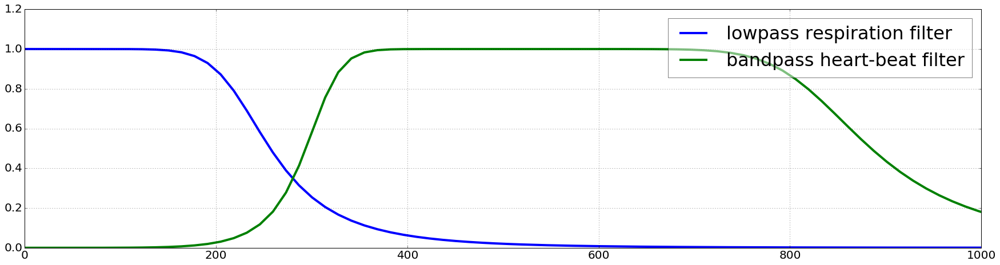

In [913]:
def compute_phase_correlation_signal(imInput):
    
    numFrames = imInput.shape[-1]
    
    sig = np.zeros(numFrames - 1)
    
    for i in range(1, numFrames):
        
        cur_fft = np.fft.fft2(imInput[:, :, i])
        prev_fft = np.fft.fft2(imInput[:, :, i-1])
        prev_fft_conj = np.ma.conjugate(prev_fft)
        
        R = cur_fft * prev_fft_conj
        R /= np.absolute(R)
        
        sig[i-1] = np.absolute(R.sum())
        
    return sig

heart_band_bpm = [310, 840]
resp_cutoff_bpm = 230

order = 5

cutoff = resp_cutoff_bpm / 60.0
nyq = 0.5 * framesPerSec
b, a = scipy.signal.butter(order, cutoff / nyq, btype='low')

w, h = scipy.signal.freqz(b, a)
plt.plot(nyq * w / np.pi * 60.0, np.abs(h), label='lowpass respiration filter')
plt.xlim([0, 840])

pass_band = np.array(heart_band_bpm) / 60.0
nyq = 0.5 * framesPerSec
b, a = scipy.signal.butter(order, pass_band / nyq, btype='bandpass')

w, h = scipy.signal.freqz(b, a)
plt.plot(nyq * w / np.pi * 60.0, np.abs(h), label='bandpass heart-beat filter')
plt.xlim([0, 1000])

plt.legend(framealpha=0.5)

## Phase correlation approach by Sundar et. al.

Reference:

* Sundar, Hari, et al. "[Automatic image-based cardiac and respiratory cycle synchronization and gating of image sequences.](https://www.cs.utah.edu/~hari/files/pubs/miccai09b.pdf)" MICCAI 2009.

In [914]:
sig_phcorr = utils.normalizeArray(compute_phase_correlation_signal(imInput))

sig_phcorr_heart = utils.normalizeArray(uspgs.bpass_filter(sig_phcorr, framesPerSec, heart_band_bpm))

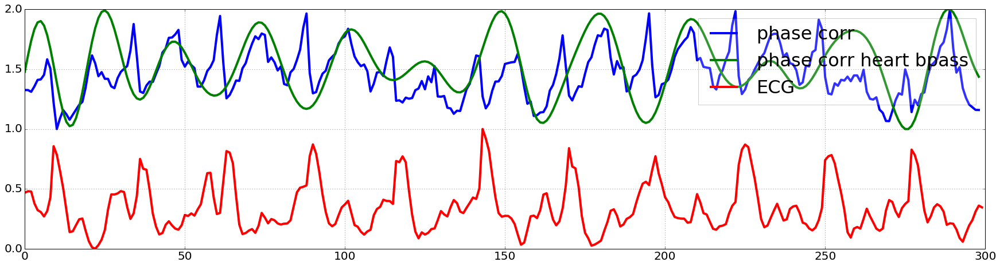

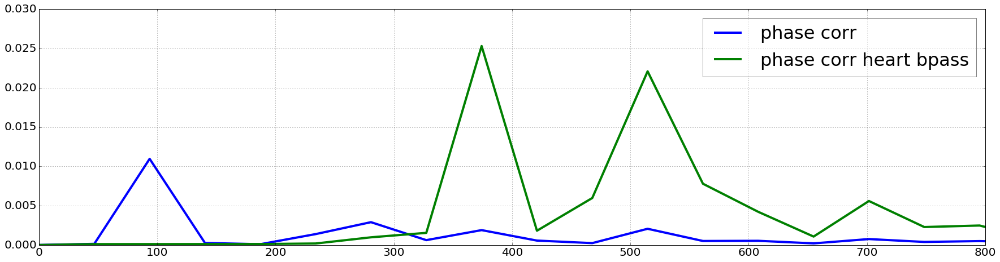

In [915]:
plt.figure()
plt.plot(sig_phcorr+1, label="phase corr")
plt.plot(sig_phcorr_heart+1, label="phase corr heart bpass")
plt.plot(ecg_norm)
plt.legend(framealpha=0.2)

plt.figure()

freq_sig_phcorr, power_sig_phcorr = scipy.signal.periodogram(sig_phcorr, fs=framesPerSec)
plt.plot(freq_sig_phcorr * 60, power_sig_phcorr, label='phase corr')

freq_sig_phcorr_heart, power_sig_phcorr_heart = scipy.signal.periodogram(sig_phcorr_heart, fs=framesPerSec)
plt.plot(freq_sig_phcorr_heart * 60, power_sig_phcorr_heart, label='phase corr heart bpass')

plt.xlim([0, 800])
plt.legend(framealpha=0.5)

In [916]:
ph_phcorr_vloc = detect_peaks(sig_phcorr_heart, mpd=algo.period_ * 0.65, valley=True, show=False)

print ph_phcorr_vloc
print qrs_ploc

num_points = min([qrs_ploc.size, ph_phcorr_vloc.size])

print '\nR^2 estimated vs groundtruth = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                    ph_phcorr_vloc[:num_points])

qrs_loc_diff = np.abs(ph_phcorr_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between estimated and groundtruth qrs peak locations: \n\t', qrs_loc_diff
print '\tMean = %.2f, std = %.2f' % (np.mean(qrs_loc_diff), np.std(qrs_loc_diff))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(qrs_loc_diff), scipy.stats.iqr(qrs_loc_diff))

[ 14  36  59  88 115 136 162 194 223 242 276]
[  9  36  63  90 118 143 170 197 225 252 277]

R^2 estimated vs groundtruth =  0.996462763462

Difference between estimated and groundtruth qrs peak locations: 
	[ 5  0  4  2  3  7  8  3  2 10  1]
	Mean = 4.09, std = 2.97
	Median = 3.00, IQR = 4.00


### Manifold learning approach by Wachinger et. al.

Reference:
    
* Wachinger et. al "[Manifold learning for image-based breathing gating in ultrasound and MRI](https://www.ncbi.nlm.nih.gov/pubmed/22226466)", MIA, 2011

In [917]:
import sklearn.manifold 

se = sklearn.manifold.SpectralEmbedding(n_components=2, affinity='precomputed')

X = np.reshape(imInput, (np.prod(imInput.shape[:2]), imInput.shape[-1])).T
# affMat = 1 - scipy.spatial.distance.cdist(X, X, 'correlation')

X = sklearn.preprocessing.scale(X, axis=1)
affMat = scipy.spatial.distance.cdist(X, X, 'sqeuclidean')
affMat = affMat.max() - affMat

se_proj = se.fit_transform(affMat)

sig_se_heart = utils.normalizeArray(uspgs.bpass_filter(se_proj[:, 1], framesPerSec, heart_band_bpm))
sig_se_resp = utils.normalizeArray(uspgs.lpass_filter(se_proj[:, 0], framesPerSec, resp_cutoff_bpm))

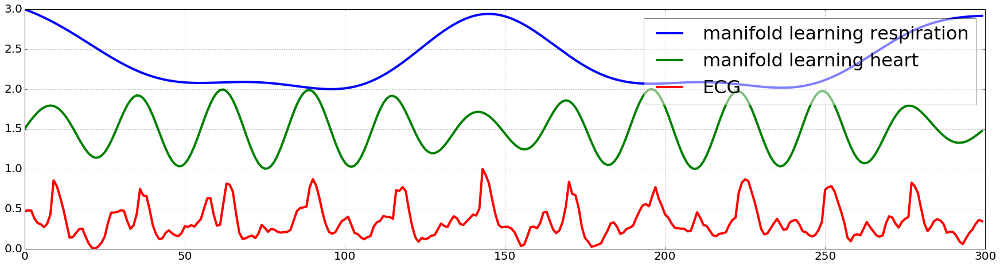

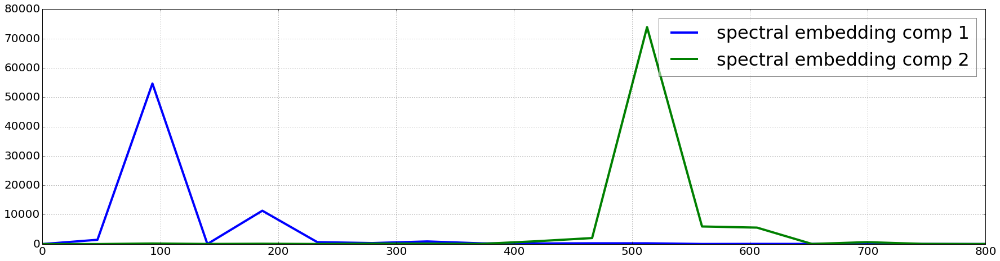

In [918]:
plt.figure()

plt.plot(sig_se_resp+2, label='manifold learning respiration')
plt.plot(sig_se_heart+1, label='manifold learning heart')
plt.plot(ecg_norm)
plt.legend(framealpha=0.5)

plt.figure()

freq_sig_se_1, power_sig_se_1 = scipy.signal.periodogram(se_proj[:, 0], fs=framesPerSec)
plt.plot(freq_sig_se_1 * 60, power_sig_se_1, label='spectral embedding comp 1')

freq_sig_se_2, power_sig_se_2 = scipy.signal.periodogram(se_proj[:, 1], fs=framesPerSec)
plt.plot(freq_sig_se_2 * 60, power_sig_se_2, label='spectral embedding comp 2')

plt.xlim([0, 800])
plt.legend(framealpha=0.5)

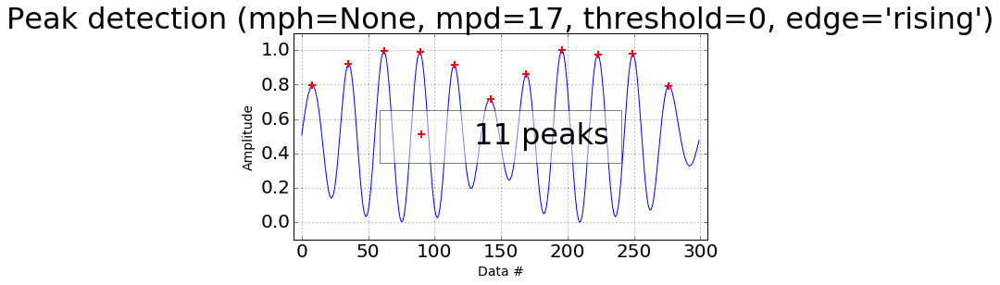

[  8  35  62  89 115 142 169 196 223 249 276]
[  9  36  63  90 118 143 170 197 225 252 277]

R^2 estimated vs groundtruth qrs peak locations =  0.999622359088

Difference between estimated and groundtruth qrs peak locations: 
	[1 1 1 1 3 1 1 1 2 3 1]
	Mean = 1.4545, std = 0.7820
	Median = 1.00, IQR = 0.50


In [919]:
ph_se_vloc = detect_peaks(sig_se_heart, mpd=algo.period_ * 0.65, valley=False, show=True)

print ph_se_vloc
print qrs_ploc

num_points = min([qrs_ploc.size, ph_se_vloc.size])

print '\nR^2 estimated vs groundtruth qrs peak locations = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                                       ph_se_vloc[:num_points])

qrs_loc_diff = np.abs(ph_se_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between estimated and groundtruth qrs peak locations: \n\t', qrs_loc_diff
print '\tMean = %.4f, std = %.4f' % (np.mean(qrs_loc_diff), np.std(qrs_loc_diff))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(qrs_loc_diff), scipy.stats.iqr(qrs_loc_diff))

### Masked PCA approach by Panayiotou et. al.

Reference:

* Panayiotou et. al., "[A statistical method for retrospective cardiac and respiratory motion gating of interventional cardiac X-ray images](https://tinyurl.com/y8oan54l)", Medical Physics, 2014

000 001 002 003 004 005 006 007 008 009 010 011 012 013 014 015 016 017 018 019 020 021 022 023 024 025 026 027 028 029 030 031 032 033 034 035 036 037 038 039 040 041 042 043 044 045 046 047 048 049 050 051 052 053 054 055 056 057 058 059 060 061 062 063 064 065 066 067 068 069 070 071 072 073 074 075 076 077 078 079 080 081 082 083 084 085 086 087 088 089 090 091 092 093 094 095 096 097 098 099 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 

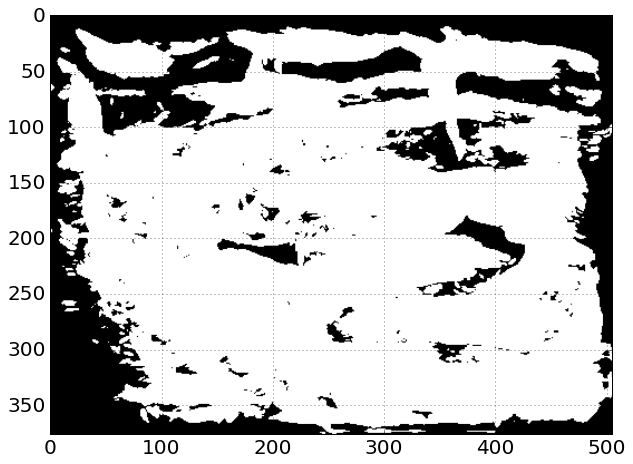

In [920]:
imFrangi = np.zeros_like(imInput, dtype=np.float) 

for i in range(imInput.shape[2]):
    print '%.3d' % i, 
    imFrangi[:, :, i] = skimage.filters.frangi(imInput[:, :, i], scale_range=(5, 10))
    
th_otsu = skimage.filters.threshold_otsu(imFrangi)
imPCAMask = np.max(imFrangi > th_otsu, 2)

plt.imshow(imPCAMask)

In [921]:
if DEBUG_MODE:
    
    utils.cvShowVideo([utils.normalizeArray(imInput), 
                       utils.normalizeArray(imFrangi), utils.normalizeArray(imFrangi > th_otsu)], 
                      ['Input video', 'Frangi Video', 'Frangi threshold'], resizeAmount=resizeAmount)

In [922]:
pca = sklearn.decomposition.PCA(n_components = 2)

X = np.reshape(imInput, (np.prod(imInput.shape[:2]), imInput.shape[-1])).T
X = X[:, imPCAMask.ravel()]

pca_proj = pca.fit_transform(X)

sig_pca_heart = utils.normalizeArray(uspgs.bpass_filter(pca_proj[:, 1], framesPerSec, heart_band_bpm))
sig_pca_resp = utils.normalizeArray(uspgs.lpass_filter(pca_proj[:, 0], framesPerSec, resp_cutoff_bpm))

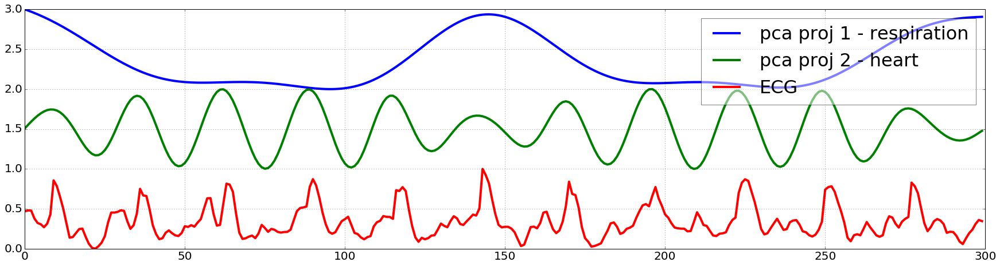

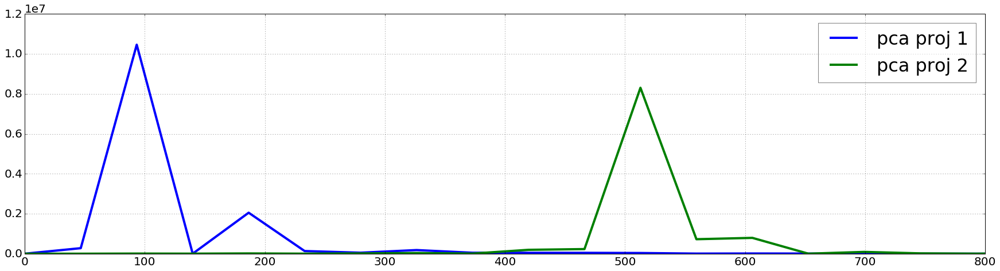

In [923]:
plt.figure()

plt.plot(sig_pca_resp+2, label='pca proj 1 - respiration')
plt.plot(sig_pca_heart+1, label='pca proj 2 - heart')
plt.plot(ecg_norm)
plt.legend(framealpha=0.5)

plt.figure()

freq_sig_pca_1, power_sig_pca_1 = scipy.signal.periodogram(pca_proj[:, 0], fs=framesPerSec)
plt.plot(freq_sig_pca_1 * 60, power_sig_pca_1, label='pca proj 1')

freq_sig_pca_2, power_sig_pca_2 = scipy.signal.periodogram(pca_proj[:, 1], fs=framesPerSec)
plt.plot(freq_sig_pca_2 * 60, power_sig_pca_2, label='pca proj 2')

plt.xlim([0, 800])
plt.legend(framealpha=0.5)

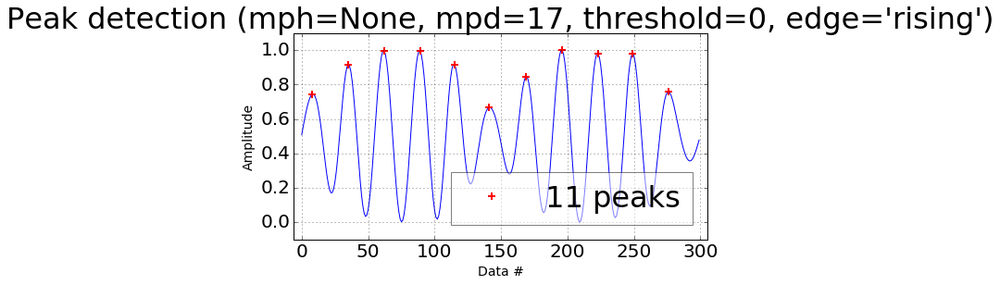

[  8  35  62  89 115 141 169 196 223 249 276]
[  9  36  63  90 118 143 170 197 225 252 277]

R^2 estimated vs groundtruth qrs peak locations =  0.999584594997

Difference between estimated and groundtruth qrs peak locations: 
	[1 1 1 1 3 2 1 1 2 3 1]
	Mean = 1.55, std = 0.78
	Median = 1.00, IQR = 1.00


In [924]:
ph_pca_vloc = detect_peaks(sig_pca_heart, mpd=algo.period_ * 0.65, valley=False, show=True)

print ph_pca_vloc
print qrs_ploc

num_points = min([qrs_ploc.size, ph_pca_vloc.size])

print '\nR^2 estimated vs groundtruth qrs peak locations = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                                       ph_pca_vloc[:num_points])

qrs_loc_diff = np.abs(ph_pca_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between estimated and groundtruth qrs peak locations: \n\t', qrs_loc_diff
print '\tMean = %.2f, std = %.2f' % (np.mean(qrs_loc_diff), np.std(qrs_loc_diff))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(qrs_loc_diff), scipy.stats.iqr(qrs_loc_diff))

#### Figures depicting respiratory gating

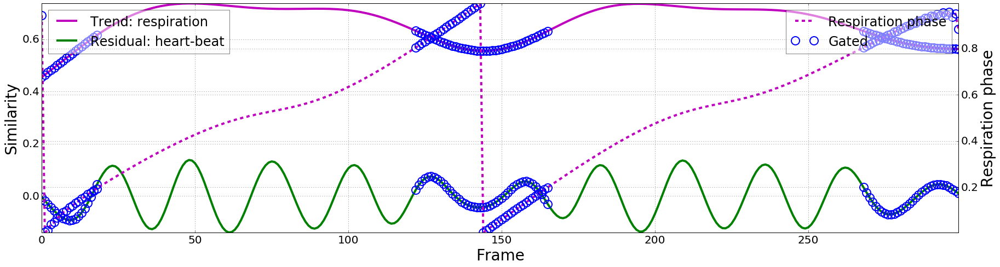

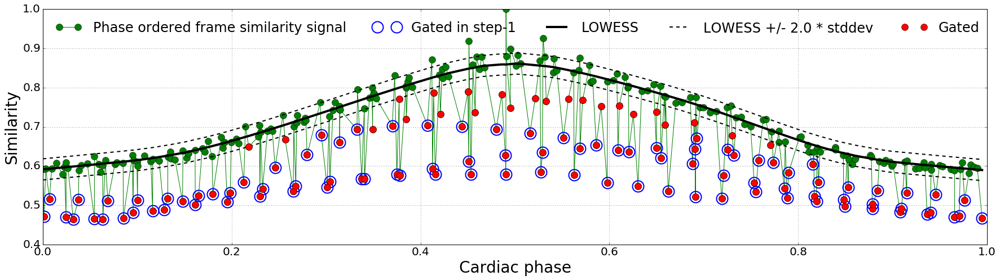

In [925]:
# show initial phase based respiration gating
ts_seasonal_norm = utils.normalizeArray(ts_seasonal)
ts_trend_norm = utils.normalizeArray(ts_trend)

fig, ax1 = plt.subplots(1)

ax1.plot(ts_trend, 'm-', label='Trend: respiration')
ax1.plot(resp_ind, ts_trend[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2)

ax1.plot(ts_seasonal, 'g-', label='Residual: heart-beat')

ax1.plot(resp_ind, ts_seasonal[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2)

ax1.set_xlabel('Frame')
ax1.set_ylabel('Similarity')
ax1.legend(framealpha=0.5, loc='upper left', fontsize=labelsize-4);
ax1.axis('tight')

ax2 = ax1.twinx()
ax2.plot(ts_trend_instaphase_nmzd, 'm--', label='Respiration phase')
ax2.plot(resp_ind, ts_trend_instaphase_nmzd[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2,
         label='Gated')

ax2.set_ylabel('Respiration phase')
ax2.legend(framealpha=0.5, loc='upper right', fontsize=labelsize-4);
ax2.axis('tight')

utils.SaveFigToDisk(resultsDir, 'respiratory_phase_gating', bbox_inches='tight')

# show lowess based gating
phaseord_est = np.argsort(ts_instaphase_nmzd)

fid_lowess = algo.fid_lowess_
sim_lowess_reg = algo.sim_lowess_reg_

ph_resp = ts_instaphase_nmzd[resp_ind]
sim_resp = simMat[fid_lowess, resp_ind]

ph_org = ts_instaphase_nmzd[phaseord_est]
sim_org = simMat[fid_lowess, phaseord_est]

sim_lowess = sim_lowess_reg.predict(ph_org)

k_mad = 2.0
gated_ind = phaseord_est[np.argwhere(sim_lowess - sim_org > k_mad * sim_lowess_reg.residual_mad())]

ph_gated = ts_instaphase_nmzd[gated_ind]
sim_gated = simMat[fid_lowess, gated_ind]

phaseord_est_gated = [fid for fid in phaseord_est if fid not in gated_ind]
imInput_phaseord_est = imInput[:,:,phaseord_est_gated]
imInputDenoised_phaseord_est = imInputDenoised[: , :, phaseord_est_gated]

fig, ax = plt.subplots(1)

ax.plot(ph_org, sim_org, 'g-o', label=r'Phase ordered frame similarity signal', linewidth=linewidth/4)
ax.plot(ph_resp, sim_resp, 'bo', label='Gated in step-1',
        fillstyle='none', markersize=20, markeredgewidth=linewidth/2)
ax.plot(ph_org, sim_lowess, 'k-', label='LOWESS', linewidth=linewidth)

ax.plot(ph_org, sim_lowess + k_mad * sim_lowess_reg.residual_mad(), 'k--', 
         label='LOWESS +/- %.1f * stddev' % k_mad, linewidth=linewidth/2)
ax.plot(ph_org, sim_lowess - k_mad * sim_lowess_reg.residual_mad(), 'k--', linewidth=linewidth/2)

ax.plot(ph_gated, sim_gated, 'ro', label='Gated')

ax.set_xlabel('Cardiac phase')
ax.set_ylabel('Similarity')

plt.legend(bbox_to_anchor=(0.0, 1.0), loc='upper left', ncol=5, framealpha=0, fontsize=labelsize-4)

# _ = ax.legend(loc='upper left', framealpha=0.5)

utils.SaveFigToDisk(resultsDir, 'robust_lowess_gating', bbox_inches='tight')

#### Video depicting noise suppression

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/NoiseSuppressionResult.avi took 4.2059841156 seconds


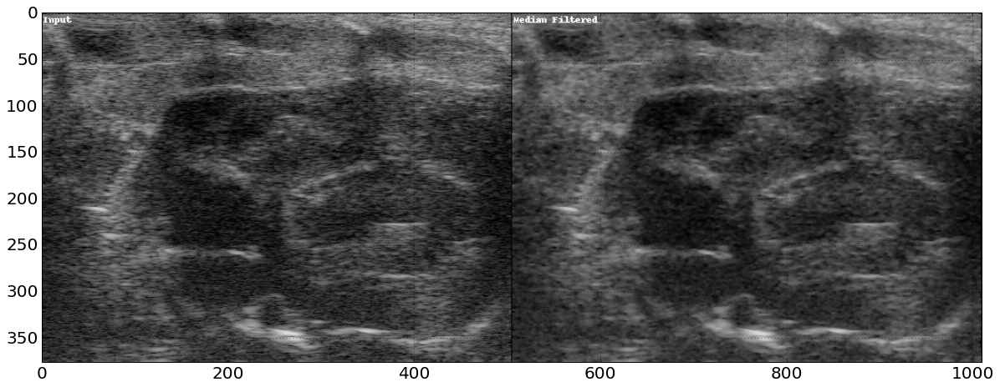

In [926]:
if algo_params['apply_lr_denoising']:

    imNoiseSuppressionVideo = np.zeros_like( np.tile(imInput, (2, 2, 1)) )

    rsize, csize, nframes  = imInput.shape
    imNoiseSuppressionVideo[:rsize, :csize, :] = utils.AddTextOnVideo( imInput, 'Input' )
    imNoiseSuppressionVideo[:rsize, csize:, :] = utils.AddTextOnVideo( imD, 'Median Filtered' )
    imNoiseSuppressionVideo[rsize:, :csize, :] = utils.AddTextOnVideo( imLowRank, 'Low-rank' )
    imNoiseSuppressionVideo[rsize:, csize:, :] = utils.AddTextOnVideo( normalizeArray(imSparse) * 255, 'Sparse' )

else:

    imNoiseSuppressionVideo = np.zeros_like( np.tile(imInput, (1, 2, 1)) )

    rsize, csize, nframes  = imInput.shape
    imNoiseSuppressionVideo[:rsize, :csize, :] = utils.AddTextOnVideo( imInput, 'Input' )
    imNoiseSuppressionVideo[:rsize, csize:, :] = utils.AddTextOnVideo( imInputDenoised, 'Median Filtered' )

# write our result
utils.writeVideoToFile(
    utils.normalizeArray(imNoiseSuppressionVideo) * 255, 
    os.path.join(resultsDir, 'NoiseSuppressionResult.avi'), 
    codec='DIVX', fps=outFPS
)    
    
# show mip
plt.figure()
plt.imshow(imNoiseSuppressionVideo[:, :, 0])

In [927]:
if DEBUG_MODE:
    
    if algo_params['apply_lr_denoising']:

        utils.cvShowVideo(
            [utils.normalizeArray(imInput), 
             utils.normalizeArray(imLowRank, input_bounds), utils.normalizeArray(imSparse, input_bounds)],
            ['Input video', 'Lowrank video', 'Sparse video'], resizeAmount=resizeAmount
        )

    else:

        utils.cvShowVideo(
            [utils.normalizeArray(imInput), utils.normalizeArray(imInputDenoised, input_bounds)],
            ['Input video', 'Denoised video'], resizeAmount=resizeAmount
        )

#### Video depicting phase estimation

 True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/PhaseEstimationResult.avi took 8.77497220039 seconds


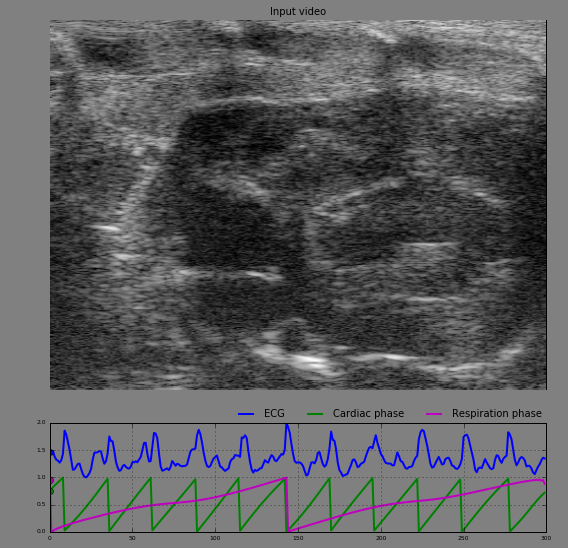

In [942]:
if True: # DEBUG_MODE:
    
    imPhaseEstimationVideo = []

    for i in range(imInput.shape[2]):

        print i, 

        fig = plt.figure(figsize=(8, 8))
        fig.patch.set_facecolor('gray')

        gs = gridspec.GridSpec(2, 1, height_ratios=[4, 1])
        gs.update(wspace=0, hspace=0) # set the spacing between axes.

        ax1 = plt.subplot(gs[0])
        ax1.imshow(imInput[:, :, i])
        ax1.set_title('Input video', fontsize=10)
        ax1.axis('off')

        ax2 = plt.subplot(gs[1], axisbg='gray')

        ax2.plot(1 + ecg_norm, 'b-', linewidth= 2, label='ECG')
        ax2.plot(i, 1 + ecg_norm[i], 'bo', markersize=markersize/2)

        ax2.plot(ts_instaphase_nmzd, 'g-', linewidth= 2, label='Cardiac phase')
        ax2.plot(i, ts_instaphase_nmzd[i], 'go', markersize=markersize/2)

        ax2.plot(ts_trend_instaphase_nmzd, 'm-', linewidth= 2, label='Respiration phase')
        ax2.plot(i, ts_trend_instaphase_nmzd[i], 'mo', markersize=markersize/2)

        ax2.tick_params(labelsize=6)
        plt.legend(bbox_to_anchor=(1.01, 0.95), loc='lower right', ncol=3, framealpha=0, fontsize=10)

        plt.tight_layout()

        imFig = utils.fig2data(fig)
        imPhaseEstimationVideo.append(imFig)

        display(plt.gcf())
        clear_output(wait=True)
        time.sleep(1.0 / 60.0)

        # del fig
        if i > 0:
            _ = fig.clear()

    imPhaseEstimationVideo = np.stack(imPhaseEstimationVideo, axis=3)

    # write our result
    utils.writeVideoToFile(
        imPhaseEstimationVideo, 
        os.path.join(resultsDir, 'PhaseEstimationResult.avi'), 
        codec='MJPG', fps=outFPS, isColor=True
    )

#### Video depicting super-resolution

/home/deepak.chittajallu/.virtualenvs/lcus/lib/python2.7/site-packages/ipykernel_launcher.py:6: DeprecationWarning: object of type <type 'numpy.float64'> cannot be safely interpreted as an integer.
  


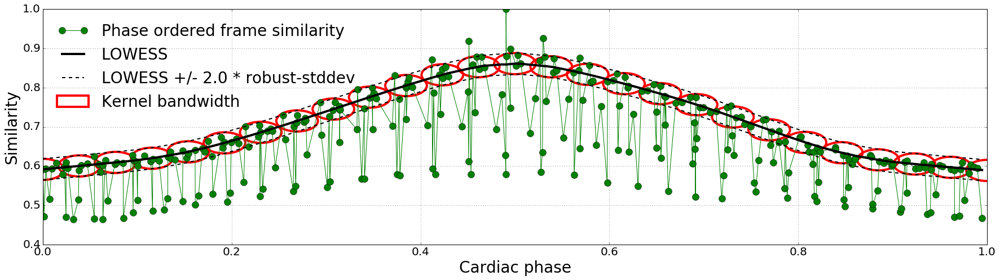

In [929]:
# tweak and visualize sigma factors for kernel regression
kPhase = 0.4
kSim = 2
mag = 1

synthPhaseVals = np.linspace(0, 1, np.round(period))

phaseord_est = np.argsort(algo.ts_instaphase_nmzd_)

ph_org = algo.ts_instaphase_nmzd_[phaseord_est]
sim_org = algo.ts_[phaseord_est]

sim_lowess = algo.sim_lowess_reg_.predict(ph_org)
sim_mad = algo.sim_lowess_reg_.residual_mad()

pdiff = uspgs.phaseDiff(algo.ts_instaphase_nmzd_)
pstd = sm.robust.scale.mad(pdiff, center=0)
# pstd = np.mean(superUS.phaseDiff(np.sort(algo.ts_instaphase_nmzd_)))

synthPhaseSims = algo.sim_lowess_reg_.predict(synthPhaseVals)

wPhase = 2 * kPhase * pstd
wSim = 2 * kSim * sim_mad

# Display
fig, ax = plt.subplots(1)

ax.plot(ph_org, sim_org, 'g-o', label='Phase ordered frame similarity', linewidth=linewidth/4)
ax.plot(ph_org, sim_lowess, 'k-', label='LOWESS', linewidth=linewidth)

ax.plot(ph_org, sim_lowess + k_mad * sim_lowess_reg.residual_mad(), 'k--', 
         label='LOWESS +/- %.1f * robust-stddev' % k_mad, linewidth=linewidth/2)
ax.plot(ph_org, sim_lowess - k_mad * sim_lowess_reg.residual_mad(), 'k--', linewidth=linewidth/2)

i = 0

for cur_ph, cur_sim in zip(synthPhaseVals, synthPhaseSims):
    
    c = [cur_ph, cur_sim]
    
    if i == 0:
        patch_label = 'Kernel bandwidth'
    else:
        patch_label = None
        
    cur_el = mpatches.Ellipse(xy=c, width=wPhase, height=wSim, label=patch_label,
                              fill=False, color='r', linewidth=linewidth)
    ax.add_patch(cur_el)
    
    i += 1
    
ax.set_xlabel('Cardiac phase')
ax.set_ylabel('Similarity')

plt.legend(loc='upper left', framealpha=0, fontsize=labelsize)

utils.SaveFigToDisk(resultsDir, 'phase_similarity_bandwidth', bbox_inches='tight')

upsampling by 1 using kernel_regression_phase_sim (27 samples/cycle)
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/OnePeriodVideo_Mag_1_kernel_regression_phase_sim.avi took 0.174515962601 seconds


upsampling by 2 using kernel_regression_phase_sim (54 samples/cycle)
01% 03% 05% 07% 09% 11% 12% 14% 16% 18% 20% 22% 24% 25% 27% 29% 31% 33% 35% 37% 38% 40% 42% 44% 46% 48% 50% 51% 53% 55% 57% 59% 61% 62% 64% 66% 68% 70% 72% 74% 75% 77% 79% 81% 83% 85% 87% 88% 90% 92% 94% 96% 98% 

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/OnePeriodVideo_Mag_2_kernel_regression_phase_sim.avi took 0.243403911591 seconds


upsampling by 4 using kernel_regression_phase_sim (108 samples/cycle)
01% 02% 03% 04% 05% 06% 07% 08% 09% 10% 11% 12% 13% 14% 15% 16% 17% 18% 19% 20% 21% 22% 23% 24% 25% 26% 27% 28% 29% 30% 

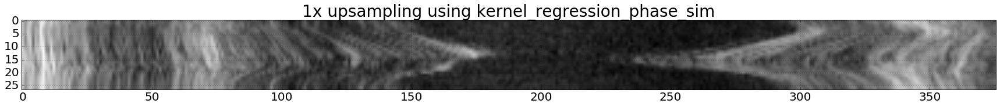

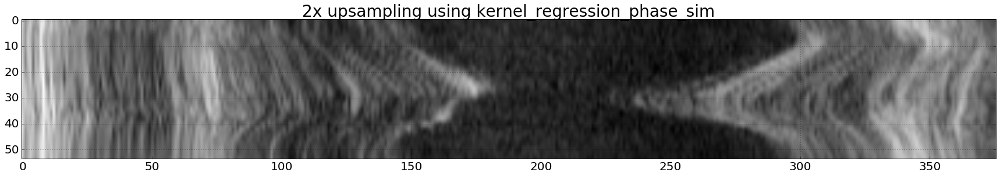

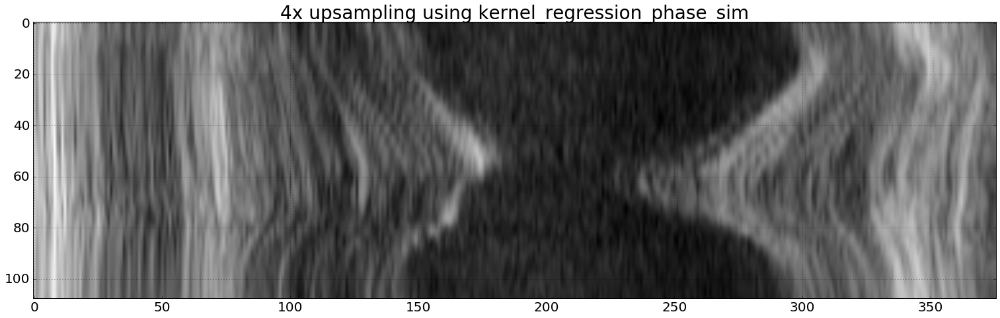

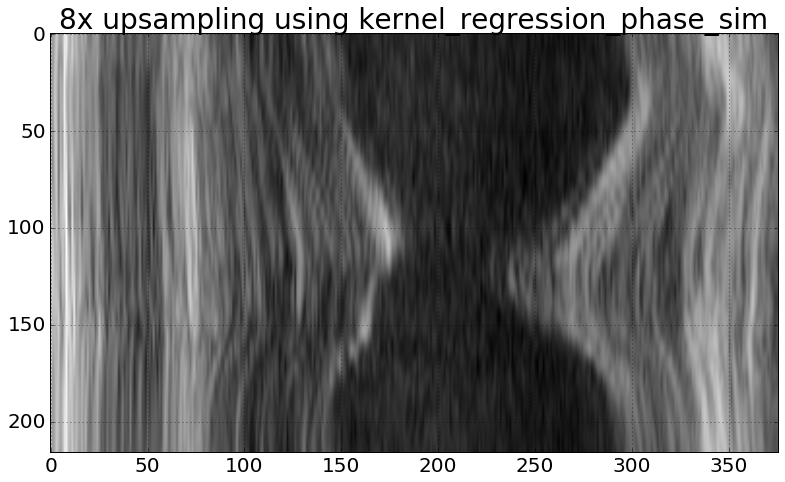

In [930]:
# set parmeters
upsampleAmountList = np.array([1, 2, 4, 8])
sigmaSimilarityFactor = kSim
sigmaPhaseFactor = kPhase

linear_interp_params = uspgs.config_framegen_using_linear_interpolation()

kreg_params = uspgs.config_framegen_using_kernel_regression(sigmaPhaseFactor=sigmaPhaseFactor)

kreg_params_sim = uspgs.config_framegen_using_kernel_regression(
    sigmaPhaseFactor=sigmaPhaseFactor, 
    sigmaSimilarityFactor=sigmaSimilarityFactor, 
    stochastic=False)

mparams_list = [kreg_params_sim]

# generate one-period video at higher resolution
outVideoList = []

for mparams in mparams_list:    

    for upsampleAmount in upsampleAmountList:    

        numOutFrames = np.round(period) * upsampleAmount
        
        print 'upsampling by %d using %s (%d samples/cycle)' % (upsampleAmount, mparams['name'], numOutFrames)

        imCurOnePeriodVideo_Input = algo.generate_single_cycle_video(numOutFrames, 
                                                                     imInput=imInput, 
                                                                     method=mparams)
        
        if algo_params['apply_lr_denoising']:
            
            imCurOnePeriodVideo_Lowrank = algo.generate_single_cycle_video(numOutFrames, 
                                                                           imInput=imLowRank, 
                                                                           method=mparams)

        rsize, csize, nframes  = imCurOnePeriodVideo_Input.shape
        
        # generate images
        utils.SaveImageToDisk(imCurOnePeriodVideo_Input[:, mmode_pos, :],
                              resultsDir, 'Input_Mag_%d_%s' % (upsampleAmount, mparams['name']))

        if algo_params['apply_lr_denoising']:
        
            utils.SaveImageToDisk(imCurOnePeriodVideo_Lowrank[:, mmode_pos, :].T,
                                  resultsDir, 'LowRank_Mag_%d_%s' % (upsampleAmount, mparams['name']))
        
        # generate demo video
        if algo_params['apply_lr_denoising']:

            imCurOnePeriodVideo = np.zeros_like(np.tile(imCurOnePeriodVideo_Input, (1, 2, 1)))

            imCurOnePeriodVideo[:rsize, :csize, :] = utils.AddTextOnVideo(imCurOnePeriodVideo_Input,
                                                                          'Input Mag %d' % upsampleAmount)
            imCurOnePeriodVideo[:rsize, csize:, :] = utils.AddTextOnVideo(imCurOnePeriodVideo_Lowrank,
                                                                          'Low-rank Mag %d' % upsampleAmount)
        else:
            
            
            imCurOnePeriodVideo = utils.AddTextOnVideo(imCurOnePeriodVideo_Input,
                                                       'Input Mag %d' % upsampleAmount)
            
        utils.writeVideoToFile(
            utils.normalizeArray(imCurOnePeriodVideo) * 255, 
            os.path.join(resultsDir, 
                         'OnePeriodVideo_Mag_%d_%s.avi' % (upsampleAmount, mparams['name']) ), 
            codec='DIVX', fps=outFPS
        )

        plt.figure()
        plt.imshow(imCurOnePeriodVideo_Input[:, mmode_pos, :].T)
        plt.title('%dx upsampling using %s' % (upsampleAmount, mparams['name']), fontsize=labelsize)
        
        print '\n'

#### LOOCV validation of phase based image reconsturction

In [931]:
num_rounds = 50
print 'LOOCV - %d rounds - bivariate phase + similarity kernel' % num_rounds

mvals = algo.validate_frame_generation(k=1, rounds=num_rounds, method=kreg_params_sim, 
                                       metric='ncorr', k_mad=2.0, exclude_similar_phase_frames=True)
print '\tmean = %.4f, std = %.4f' % (np.mean(mvals), np.std(mvals))
print '\tmedian = %.4f, IQR = %.4f' % (np.median(mvals), scipy.stats.iqr(mvals))

LOOCV - 50 rounds - bivariate phase + similarity kernel
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 
[ 0.84090354  0.77502781  0.83448366  0.83993524  0.77023957  0.77533741
  0.76510592  0.80986541  0.84593875  0.8631742   0.81036281  0.86469365
  0.85653215  0.79169098  0.82403708  0.83349514  0.80910964  0.8467172
  0.8522976   0.84010693  0.8415685   0.77953786  0.86440056  0.84526585
  0.77159449  0.76510592  0.77578384  0.83952535  0.85508189  0.81256588
  0.83349514  0.85311628  0.77926148  0.85605941  0.82324796  0.85516111
  0.78820043  0.83998803  0.85818717  0.81036281  0.8046199   0.83363801
  0.81155859  0.84833623  0.8573457   0.8022086   0.83349514  0.84251937
  0.84009239  0.76875784]
	mean = 0.8228, std = 0.0311
	median = 0.8336, IQR = 0.0437


In [932]:
num_rounds = 50
print 'LOOCV - %d rounds - univariate phase kernel' % num_rounds

mvals = algo.validate_frame_generation(k=1, rounds=num_rounds, method=kreg_params, 
                                       metric='ncorr', exclude_similar_phase_frames=True)
print '\tmean = %.4f, std = %.4f' % (np.mean(mvals), np.std(mvals))
print '\tmedian = %.4f, IQR = %.4f' % (np.median(mvals), scipy.stats.iqr(mvals))

LOOCV - 50 rounds - univariate phase kernel
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 
[ 0.8347777   0.7753432   0.83184151  0.83798763  0.76740916  0.77930198
  0.76283504  0.80495039  0.83740337  0.85030276  0.80510678  0.85288048
  0.84561928  0.79034178  0.8191133   0.82665685  0.8074388   0.84188749
  0.84461479  0.83499102  0.83445189  0.77490219  0.86213965  0.84194557
  0.77191108  0.76283504  0.77543177  0.83191863  0.8448907   0.80848041
  0.82665685  0.8440856   0.78043643  0.84572162  0.81655836  0.84613064
  0.78276673  0.83748482  0.84729758  0.80510678  0.8027702   0.82775544
  0.81031936  0.84109824  0.84583941  0.79567154  0.82665685  0.83708688
  0.83600134  0.76488159]
	mean = 0.8176, std = 0.0286
	median = 0.8272, IQR = 0.0442


In [933]:
# compute similarity statistics between QRS peak frames
sim_qrs = []

valid_ind = algo.resp_ind_

for i in range(len(qrs_ploc)):
    
    if qrs_ploc[i] in valid_ind:
        continue
        
    imA = imInput[:, :, qrs_ploc[i]]
    
    for j in range(i+1, len(qrs_ploc)):
        
        if qrs_ploc[j] in valid_ind:
            continue
            
        imB = imInput[:, :, qrs_ploc[j]]
        
        sim_qrs.append( uspgs.ncorr(imA, imB) )

print 'Similarity between QRS peak frames in the input video ...'        
print '\tmean = %.4f, std = %.4f' % (np.mean(sim_qrs), np.std(sim_qrs))
print '\tmedian = %.4f, IQR = %.4f' % (np.median(sim_qrs), scipy.stats.iqr(sim_qrs))

Similarity between QRS peak frames in the input video ...
	mean = 0.6997, std = 0.0605
	median = 0.6890, IQR = 0.0772


In [934]:
if DEBUG_MODE:

    mean_error_proposed = [1.09, 1.36, 1.18, 0.73, 1.27, 0.80]
    std_error_proposed = [1.08, 0.08, 0.03, 0.86, 0.86, 0.40]

    mean_error_phcorr = [4.09, 2.91, 3.45, 4.64, 4.70, 6.00]
    std_error_phcorr = [2.97, 2.23, 1.97, 3.75, 3.77, 3.52]

    mean_error_mlearn = [1.45, 1.82, 1.45, 1.36, 1.27, 1.00]
    std_error_mlearn = [0.78, 0.94, 1.08, 0.98, 0.86, 0.63]

    mean_error_mpca = [1.55, 1.73, 1.55, 1.18, 1.36, 1.10]
    std_error_mpca = [0.78, 1.05, 0.78, 1.03, 0.88, 0.54]

    fig, ax = plt.subplots(figsize=(10,10))
    ind = np.arange(len(mean_error_proposed)) + 1
    width = 0.15

    rects_proposed = ax.bar(ind, mean_error_proposed, width, yerr=std_error_proposed)
    rects_phcorr = ax.bar(ind+width/2, mean_error_phcorr, width, yerr=std_error_phcorr)
    rects_mlearn = ax.bar(ind+2*width/2, mean_error_mlearn, width, yerr=std_error_mlearn)
    rects_mpca = ax.bar(ind+3*width/2, mean_error_mpca, width, yerr=std_error_mpca)

    # add some text for labels, title and axes ticks
    ax.set_ylabel('Error in frames', fontsize=10)
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(ind, fontsize=10)

    ax.legend((rects_proposed[0], rects_phcorr[0], rects_mlearn[0], rects_mpca[0]), 
              ('Proposed', 'Phase correlation', 'Manifold learning', 'Masked PCA'),
              fontsize=10)

#### Validate super-resolution reconstrictions from downsampled videos

In [935]:
##### Generate groundtruth single cycle video by croppping out part between R-peaks with minimal respiration
samplesPerCycle = np.int(algo.period_ + 0.5)

resp_mask = np.zeros(imInput.shape[-1], dtype=bool)
resp_mask[gated_ind] = True

resp_frac = np.zeros(len(qrs_ploc)-1)

for i in range(len(qrs_ploc)-1):    
    resp_frac[i] = resp_mask[qrs_ploc[i]:qrs_ploc[i]+samplesPerCycle].mean()
    
print(resp_frac)

sel_ploc = np.argmin(resp_frac)
# sel_ploc = np.where(resp_frac == 0)[0]
# sel_ploc = 3

imOnePeriodVideoGT = imInput[:, :, qrs_ploc[sel_ploc]:qrs_ploc[sel_ploc]+samplesPerCycle]

[ 0.81481481  0.          0.          0.          0.92592593  0.85185185
  0.          0.          0.          0.74074074]


In [936]:
# Compute stats of consecutive frame ncorr
consec_frame_ncorr_gt = np.zeros(imOnePeriodVideoGT.shape[-1])

for i in range(imOnePeriodVideoGT.shape[-1]-1):
    
    consec_frame_ncorr_gt[i] = uspgs.ncorr(imOnePeriodVideoGT[:, :, i], imOnePeriodVideoGT[:, :, i+1])
    
print 'Consecutive frame ncorr = %f +/- %f' % (consec_frame_ncorr_gt.mean(), consec_frame_ncorr_gt.std())

# Compute min ncorr between any two frames
X = np.reshape(imOnePeriodVideoGT, (np.prod(imOnePeriodVideoGT.shape[:2]), imOnePeriodVideoGT.shape[-1])).T
fsim = 1 - scipy.spatial.distance.cdist(X, X, 'correlation')
min_ncorr_gt = fsim.min()

print 'Min frame ncorr = %f' % min_ncorr_gt    

Consecutive frame ncorr = 0.773680 +/- 0.156165
Min frame ncorr = 0.522138


In [937]:
downsample_factors = np.arange(1, 6, 1)
recon_metric = np.zeros((len(downsample_factors), 2))
num_start_offsets = 7

np.random.seed(1)
offset_list = np.sort(np.random.choice(np.arange(algo.period_/2).astype('int'), 
                                       size=num_start_offsets, replace=False))
print 'Offset list = ', offset_list

for i in range(len(downsample_factors)):

    mag = downsample_factors[i]
    framesPerSecDownsmp = framesPerSec / mag
    
    print '*****************************'
    print 'Evaluating %dx reconstruction' % mag

    cur_algo_params = algo_params.copy()
    cur_algo_params['hp_lamda'] = algo_params['hp_lamda'] /  mag

    cur_recon_metric_offset = np.zeros(num_start_offsets)
    
    for oind in range(num_start_offsets):
        
        print '---- Offset = %d ----' % offset_list[oind]
        
        cur_algo = uspgs.USPGS(**cur_algo_params)
        cur_algo.set_input(imInput[:, :, offset_list[oind]::mag], framesPerSecDownsmp)
        cur_algo.process() 
    
        imCurOnePeriodVideo = cur_algo.generate_single_cycle_video(samplesPerCycle, method=kreg_params_sim)
    
        '''
        cur_recon_metric = np.zeros(len(sel_ploc))    
        for j in range(len(sel_ploc)):
            imOnePeriodVideoGT = imInput[:, :, qrs_ploc[sel_ploc[j]]:qrs_ploc[sel_ploc[j]]+samplesPerCycle]
            cur_recon_metric[j] = uspgs.ncorr(imCurOnePeriodVideo, imOnePeriodVideoGT)

        recon_metric[i] = cur_recon_metric.mean()
        '''
    
        cur_recon_metric_offset[oind] = uspgs.ncorr(imCurOnePeriodVideo, imOnePeriodVideoGT)
        
        print 'Reconstruction metric for offset %d = %f' % (offset_list[oind], cur_recon_metric_offset[oind])
    
    recon_metric[i, 0] = cur_recon_metric_offset.mean()
    recon_metric[i, 1] = cur_recon_metric_offset.std()
    
    print 'Reconstruction metric stats = ', recon_metric[i]    

Offset list =  [ 1  2  3  4  6  7 10]
*****************************
Evaluating 1x reconstruction
---- Offset = 1 ----
Input video size:  (376, 505, 299)

>> Step-1: Suppressing noise ...


Noise suppression took 12.87 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 23.8749110699 seconds
Chose frame 47 as key frame
Estimated period = 27.18 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 31.44%

Phase estimation took 24.75 seconds

>> Done processing ... took a total of 37.62 seconds
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

Reconstruction metric for offset 1 = 0.861384
---- Offset = 2 ----
Input video size:  (376, 505, 298)

>> Step-1: Suppressing noise ...


Noise suppression took 12.85 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 23.747795105 second

Chose frame 21 as key frame
Estimated period = 13.36 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 34.01%

Phase estimation took 7.25 seconds

>> Done processing ... took a total of 13.66 seconds
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

Reconstruction metric for offset 7 = 0.867614
---- Offset = 10 ----
Input video size:  (376, 505, 145)

>> Step-1: Suppressing noise ...


Noise suppression took 6.32 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 6.56807589531 seconds
Chose frame 19 as key frame
Estimated period = 13.18 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 33.79%

Phase estimation took 6.94 seconds

>> Done processing ... took a total of 13.26 seconds
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

Reconstruction m

03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

Reconstruction metric for offset 4 = 0.855558
---- Offset = 6 ----
Input video size:  (376, 505, 74)

>> Step-1: Suppressing noise ...


Noise suppression took 3.27 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 1.70502185822 seconds
Chose frame 4 as key frame
Estimated period = 6.73 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 50.00%

Phase estimation took 1.89 seconds

>> Done processing ... took a total of 5.15 seconds
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

Reconstruction metric for offset 6 = 0.845663
---- Offset = 7 ----
Input video size:  (376, 505, 74)

>> Step-1: Suppressing noise ...


Noise suppression took 3.26 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using norma

In [938]:
print recon_metric

for i in range(recon_metric.shape[0]):
    
    print '%dx reconstruction metric stats = %f +/- %f' % (downsample_factors[i], 
                                                           recon_metric[i, 0], recon_metric[i, 1])

[[ 0.85945667  0.00465809]
 [ 0.86467979  0.00272382]
 [ 0.86195713  0.00264688]
 [ 0.84591202  0.01299806]
 [ 0.82907896  0.01931678]]
1x reconstruction metric stats = 0.859457 +/- 0.004658
2x reconstruction metric stats = 0.864680 +/- 0.002724
3x reconstruction metric stats = 0.861957 +/- 0.002647
4x reconstruction metric stats = 0.845912 +/- 0.012998
5x reconstruction metric stats = 0.829079 +/- 0.019317


Input video size:  (376, 505, 74)

>> Step-1: Suppressing noise ...


Noise suppression took 3.26 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 1.61538910866 seconds
Chose frame 11 as key frame
Estimated period = 6.73 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 33.78%

Phase estimation took 1.80 seconds

>> Done processing ... took a total of 5.05 seconds


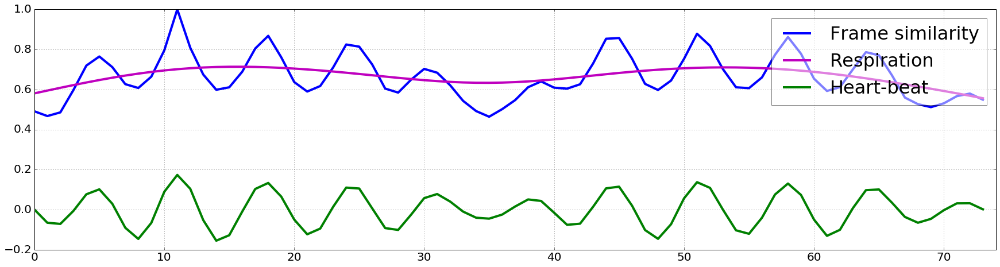

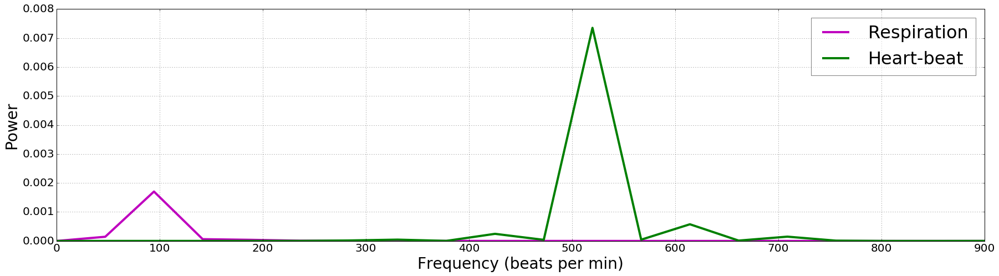

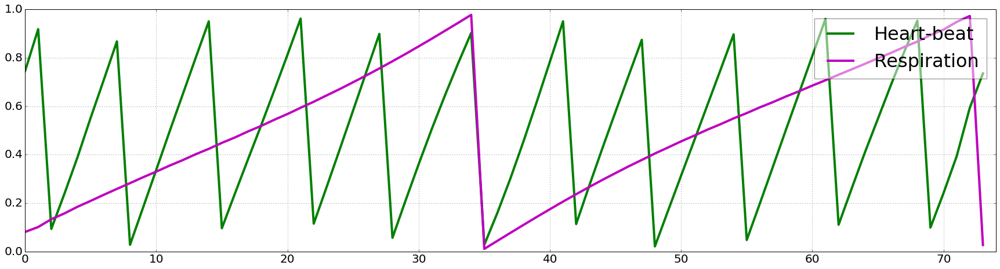

In [939]:
mag = 4
framesPerSecDownsmp = framesPerSec / mag

cur_algo_params = algo_params.copy()
cur_algo_params['hp_lamda'] = algo_params['hp_lamda'] / mag

cur_algo = uspgs.USPGS(**cur_algo_params)
cur_algo.set_input(imInput[:, :, 4::mag], framesPerSecDownsmp)
cur_algo.process() 

# show trend extraction
plt.figure()
plt.plot(cur_algo.ts_, 'b-', label='Frame similarity')
plt.plot(cur_algo.ts_trend_, 'm-', label='Respiration')
plt.plot(cur_algo.ts_seasonal_, 'g-', label='Heart-beat')
plt.xlim([0, len(cur_algo.ts_)])
plt.legend(framealpha=0.5)

# show frequency spectrum of trend and seasonal components
freq_trend, power_trend = scipy.signal.periodogram(cur_algo.ts_trend_, framesPerSecDownsmp)
freq_seasonal, power_seasonal = scipy.signal.periodogram(cur_algo.ts_seasonal_, framesPerSecDownsmp)

plt.figure()
plt.plot(freq_trend * 60, power_trend, 'm-', label='Respiration')
plt.plot(freq_seasonal * 60, power_seasonal, 'g-', label='Heart-beat')
plt.xlim([0, 900])
plt.xlabel('Frequency (beats per min)')
plt.ylabel('Power')
plt.legend(framealpha=0.5)

# show instantaneous phase
plt.figure()
plt.plot(cur_algo.ts_instaphase_nmzd_, 'g-', label='Heart-beat')
plt.plot(cur_algo.ts_trend_instaphase_nmzd_, 'm-', label='Respiration')
plt.xlim([0, len(cur_algo.ts_)])
plt.legend(framealpha=0.5)

In [940]:
if True: # DEBUG_MODE:

    imCurOnePeriodVideo = cur_algo.generate_single_cycle_video(samplesPerCycle, method=kreg_params_sim)
    utils.cvShowVideo(
        [utils.normalizeArray(imOnePeriodVideoGT), 
         utils.normalizeArray(imCurOnePeriodVideo)],
        ['Input', '%dx reconstruction' % mag], resizeAmount=resizeAmount
    )

03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 



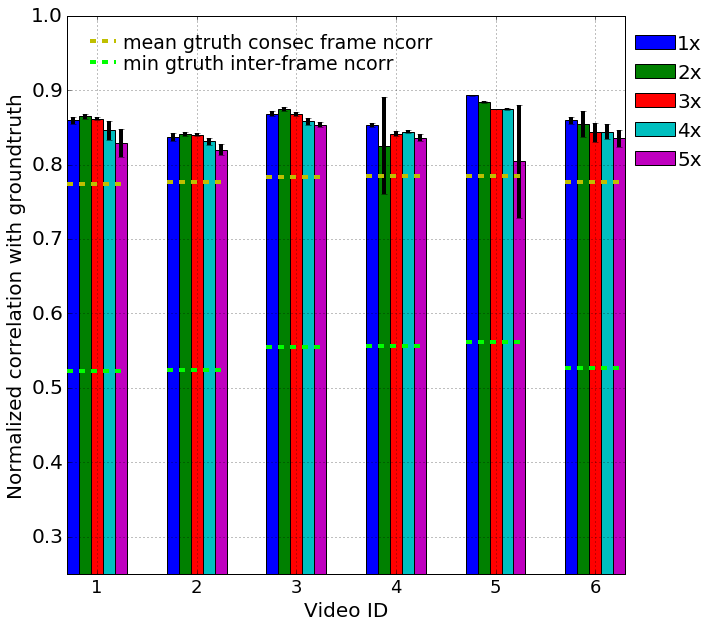

In [941]:
if True: # DEBUG_MODE:

    recon_ncorr_mean = np.array([
        [0.859457, 0.864680, 0.861957, 0.845912, 0.829079],
        [0.837365, 0.841636, 0.839899, 0.831491, 0.820254],
        [0.868550, 0.874207, 0.867879, 0.858354, 0.853792],
        [0.853361, 0.825379, 0.841307, 0.844457, 0.836344],
        [0.892878, 0.884380, 0.874733, 0.874698, 0.804172],
        [0.859498, 0.854830, 0.843365, 0.844209, 0.835551],
    ])
    
    recon_ncorr_std = np.array([
        [0.004658, 0.002724, 0.002647, 0.012998, 0.019317],
        [0.005516, 0.002739, 0.002008, 0.004908, 0.007965],
        [0.003289, 0.002584, 0.002809, 0.004803, 0.003837],
        [0.002196, 0.064894, 0.003431, 0.001848, 0.004577],
        [0.000622, 0.001042, 0.000565, 0.000718, 0.075673],
        [0.004668, 0.017300, 0.012694, 0.010373, 0.011334],
    ])
    
    consec_frame_ncorr_mean = np.array([
        0.773680, 0.777278, 0.783128, 0.785058, 0.784245, 0.776218,
    ])
    
    consec_frame_ncorr_std = np.array([
        0.156165, 0.157025, 0.156992, 0.157561, 0.156520, 0.156471
    ])
    
    min_inter_frame_ncorr = np.array([
        0.522138, 0.52385, 0.555142, 0.556752, 0.562109, 0.527038
    ])
    
    fig, ax = plt.subplots(figsize=(10,10))
    ind = np.arange(len(min_inter_frame_ncorr)) + 1
    width = 0.12

    bar_ind = 0
    
    for mag in range(1, recon_ncorr_mean.shape[1]+1):
        
        ax.bar(ind+bar_ind*width, 
               recon_ncorr_mean[:, mag-1], width, 
               yerr=recon_ncorr_std[:, mag-1], label='%dx' % mag)
        
        bar_ind += 1
        
    fsize = 18
    ax.set_xlabel('Video ID', fontsize=fsize+2)
    ax.set_ylabel('Normalized correlation with groundtruth', fontsize=fsize+2)
    ax.set_xticks(ind + (len(ind) - 1) * width / 2)
    ax.set_xticklabels(ind, fontsize=fsize)
    ax.set_ylim(bottom=0.25, top=1)
    ax.set_xlim(right=ind[-1] + recon_ncorr_mean.shape[1]*width)
    ax.legend(framealpha=0, fontsize=20, bbox_to_anchor=(1.17,1), handletextpad=0.1)
        
    axtw = ax.twinx()
    for vid in range(len(consec_frame_ncorr_mean)):
        
        ycsim = consec_frame_ncorr_mean[vid]
        xmin = ind[vid]
        xmax = xmin + width * recon_ncorr_mean.shape[1]
        
        if vid == 0:
            axtw.plot([xmin, xmax], [ycsim, ycsim], 'y--',
                      label='mean gtruth consec frame ncorr')
        else:
            axtw.plot([xmin, xmax], [ycsim, ycsim], 'y--', label=None)

        yminsim = min_inter_frame_ncorr[vid]
        
        if vid == 0:
            axtw.plot([xmin, xmax], [yminsim, yminsim], '--', color='lime',
                      label='min gtruth inter-frame ncorr')
        else:
            axtw.plot([xmin, xmax], [yminsim, yminsim], '--', color='lime',
                      label=None)
                
    axtw.axis('off')
    axtw.set_ylim(bottom=0.25, top=1)
    axtw.legend(framealpha=0, fontsize=19, loc='upper left',
                handletextpad=0.05, labelspacing=0.1)
    
    utils.SaveFigToDisk(resultsRootDir, 'single_cycle_video_reconstruction', bbox_inches='tight')